# Part 1: Data preprocessing

In [0]:
from pyspark.sql.functions import col, translate
from pyspark.sql.functions import when
import pyspark.sql.functions
from pyspark.sql.functions import isnan

In [0]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import math

## 1.0 Read data

In [0]:
# file locations
file_location_train = "/FileStore/final data/train.csv"
file_location_test = "/FileStore/final data/test.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

# CSV options are applied. For other types, these options will be ignored.
df_raw_train = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location_train)
df_raw_test = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location_test)

# show the created dataframes in record details
display(df_raw_train)
display(df_raw_test)

Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,60,RL,65,8450,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NA,Attchd,2003,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NA,NA,NA,0,2,2008,WD,Normal,208500
2,20,RL,80,9600,Pave,NA,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NA,NA,NA,0,5,2007,WD,Normal,181500
3,60,RL,68,11250,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NA,NA,NA,0,9,2008,WD,Normal,223500
4,70,RL,60,9550,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NA,NA,NA,0,2,2006,WD,Abnorml,140000
5,60,RL,84,14260,Pave,NA,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NA,NA,NA,0,12,2008,WD,Normal,250000
6,50,RL,85,14115,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NA,Attchd,1993,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NA,MnPrv,Shed,700,10,2009,WD,Normal,143000
7,20,RL,75,10084,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NA,NA,NA,0,8,2007,WD,Normal,307000
8,60,RL,NA,10382,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NA,NA,Shed,350,11,2009,WD,Normal,200000
9,50,RM,51,6120,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NA,NA,NA,0,4,2008,WD,Abnorml,129900
10,190,RL,50,7420,Pave,NA,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,GasA,Ex,Y,SBrkr,1077,0,0,1077,1,0,1,0,2,2,TA,5,Typ,2,TA,Attchd,1939,RFn,1,205,Gd,TA,Y,0,4,0,0,0,0,NA,NA,NA,0,1,2008,W

Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
1461,20,RH,80,11622,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0,TA,TA,CBlock,TA,TA,No,Rec,468,LwQ,144,270,882,GasA,TA,Y,SBrkr,896,0,0,896,0,0,1,0,2,1,TA,5,Typ,0,NA,Attchd,1961,Unf,1,730,TA,TA,Y,140,0,0,0,120,0,NA,MnPrv,NA,0,6,2010,WD,Normal
1462,20,RL,81,14267,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108,TA,TA,CBlock,TA,TA,No,ALQ,923,Unf,0,406,1329,GasA,TA,Y,SBrkr,1329,0,0,1329,0,0,1,1,3,1,Gd,6,Typ,0,NA,Attchd,1958,Unf,1,312,TA,TA,Y,393,36,0,0,0,0,NA,NA,Gar2,12500,6,2010,WD,Normal
1463,60,RL,74,13830,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0,TA,TA,PConc,Gd,TA,No,GLQ,791,Unf,0,137,928,GasA,Gd,Y,SBrkr,928,701,0,1629,0,0,2,1,3,1,TA,6,Typ,1,TA,Attchd,1997,Fin,2,482,TA,TA,Y,212,34,0,0,0,0,NA,MnPrv,NA,0,3,2010,WD,Normal
1464,60,RL,78,9978,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20,TA,TA,PConc,TA,TA,No,GLQ,602,Unf,0,324,926,GasA,Ex,Y,SBrkr,926,678,0,1604,0,0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,1998,Fin,2,470,TA,TA,Y,360,36,0,0,0,0,NA,NA,NA,0,6,2010,WD,Normal
1465,120,RL,43,5005,Pave,NA,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0,Gd,TA,PConc,Gd,TA,No,ALQ,263,Unf,0,1017,1280,GasA,Ex,Y,SBrkr,1280,0,0,1280,0,0,2,0,2,1,Gd,5,Typ,0,NA,Attchd,1992,RFn,2,506,TA,TA,Y,0,82,0,0,144,0,NA,NA,NA,0,1,2010,WD,Normal
1466,60,RL,75,10000,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1993,1994,Gable,CompShg,HdBoard,HdBoard,None,0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,763,763,GasA,Gd,Y,SBrkr,763,892,0,1655,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1993,Fin,2,440,TA,TA,Y,157,84,0,0,0,0,NA,NA,NA,0,4,2010,WD,Normal
1467,20,RL,NA,7980,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,1Story,6,7,1992,2007,Gable,CompShg,HdBoard,HdBoard,None,0,TA,Gd,PConc,Gd,TA,No,ALQ,935,Unf,0,233,1168,GasA,Ex,Y,SBrkr,1187,0,0,1187,1,0,2,0,3,1,TA,6,Typ,0,NA,Attchd,1992,Fin,2,420,TA,TA,Y,483,21,0,0,0,0,NA,GdPrv,Shed,500,3,2010,WD,Normal
1468,60,RL,63,8402,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1998,1998,Gable,CompShg,VinylSd,VinylSd,None,0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,789,789,GasA,Gd,Y,SBrkr,789,676,0,1465,0,0,2,1,3,1,TA,7,Typ,1,Gd,Attchd,1998,Fin,2,393,TA,TA,Y,0,75,0,0,0,0,NA,NA,NA,0,5,2010,WD,Normal
1469,20,RL,85,10176,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,1Story,7,5,1990,1990,Gable,CompShg,HdBoard,HdBoard,None,0,TA,TA,PConc,Gd,TA,Gd,GLQ,637,Unf,0,663,1300,GasA,Gd,Y,SBrkr,1341,0,0,1341,1,0,1,1,2,1,Gd,5,Typ,1,Po,Attchd,1990,Unf,2,506,TA,TA,Y,192,0,0,0,0,0,NA,NA,NA,0,2,2010,WD,Normal
1470,20,RL,70,8400,Pave,NA,Reg,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,4,5,1970,1970,Gable,CompShg,Plywood,Plywood,None,0,TA,TA,CBlock,TA,TA,No,ALQ,804,Rec,78,0,882,GasA,TA,Y,SBrkr,882,0,0,882,1,0,1,0,2,1,TA,4,Typ,0,NA,Attchd,1970,Fin,2,525,TA,TA,Y,240,0,0,0,0,0,NA,MnPrv,NA,0,4,2010,WD,Normal


In [0]:


df_raw_train.dtypes

Out[4]: [('Id', 'int'),
 ('MSSubClass', 'int'),
 ('MSZoning', 'string'),
 ('LotFrontage', 'string'),
 ('LotArea', 'int'),
 ('Street', 'string'),
 ('Alley', 'string'),
 ('LotShape', 'string'),
 ('LandContour', 'string'),
 ('Utilities', 'string'),
 ('LotConfig', 'string'),
 ('LandSlope', 'string'),
 ('Neighborhood', 'string'),
 ('Condition1', 'string'),
 ('Condition2', 'string'),
 ('BldgType', 'string'),
 ('HouseStyle', 'string'),
 ('OverallQual', 'int'),
 ('OverallCond', 'int'),
 ('YearBuilt', 'int'),
 ('YearRemodAdd', 'int'),
 ('RoofStyle', 'string'),
 ('RoofMatl', 'string'),
 ('Exterior1st', 'string'),
 ('Exterior2nd', 'string'),
 ('MasVnrType', 'string'),
 ('MasVnrArea', 'string'),
 ('ExterQual', 'string'),
 ('ExterCond', 'string'),
 ('Foundation', 'string'),
 ('BsmtQual', 'string'),
 ('BsmtCond', 'string'),
 ('BsmtExposure', 'string'),
 ('BsmtFinType1', 'string'),
 ('BsmtFinSF1', 'int'),
 ('BsmtFinType2', 'string'),
 ('BsmtFinSF2', 'int'),
 ('BsmtUnfSF', 'int'),
 ('TotalBsmtSF', 'int'),
 ('Heating', 'string'),
 ('HeatingQC', 'string'),
 ('CentralAir', 'string'),
 ('Electrical', 'string'),
 ('1stFlrSF', 'int'),
 ('2ndFlrSF', 'int'),
 ('LowQualFinSF', 'int'),
 ('GrLivArea', 'int'),
 ('BsmtFullBath', 'int'),
 ('BsmtHalfBath', 'int'),
 ('FullBath', 'int'),
 ('HalfBath', 'int'),
 ('BedroomAbvGr', 'int'),
 ('KitchenAbvGr', 'int'),
 ('KitchenQual', 'string'),
 ('TotRmsAbvGrd', 'int'),
 ('Functional', 'string'),
 ('Fireplaces', 'int'),
 ('FireplaceQu', 'string'),
 ('GarageType', 'string'),
 ('GarageYrBlt', 'string'),
 ('GarageFinish', 'string'),
 ('GarageCars', 'int'),
 ('GarageArea', 'int'),
 ('GarageQual', 'string'),
 ('GarageCond', 'string'),
 ('PavedDrive', 'string'),
 ('WoodDeckSF', 'int'),
 ('OpenPorchSF', 'int'),
 ('EnclosedPorch', 'int'),
 ('3SsnPorch', 'int'),
 ('ScreenPorch', 'int'),
 ('PoolArea', 'int'),
 ('PoolQC', 'string'),
 ('Fence', 'string'),
 ('MiscFeature', 'string'),
 ('MiscVal', 'int'),
 ('MoSold', 'int'),
 ('YrSold', 'int'),
 ('SaleType', 'string'),
 ('SaleCondition', 'string'),
 ('SalePrice', 'int')]

In [0]:
df_raw_train.count()

Out[5]: 1460

In [0]:
df_raw_test.dtypes

Out[6]: [('Id', 'int'),
 ('MSSubClass', 'int'),
 ('MSZoning', 'string'),
 ('LotFrontage', 'string'),
 ('LotArea', 'int'),
 ('Street', 'string'),
 ('Alley', 'string'),
 ('LotShape', 'string'),
 ('LandContour', 'string'),
 ('Utilities', 'string'),
 ('LotConfig', 'string'),
 ('LandSlope', 'string'),
 ('Neighborhood', 'string'),
 ('Condition1', 'string'),
 ('Condition2', 'string'),
 ('BldgType', 'string'),
 ('HouseStyle', 'string'),
 ('OverallQual', 'int'),
 ('OverallCond', 'int'),
 ('YearBuilt', 'int'),
 ('YearRemodAdd', 'int'),
 ('RoofStyle', 'string'),
 ('RoofMatl', 'string'),
 ('Exterior1st', 'string'),
 ('Exterior2nd', 'string'),
 ('MasVnrType', 'string'),
 ('MasVnrArea', 'string'),
 ('ExterQual', 'string'),
 ('ExterCond', 'string'),
 ('Foundation', 'string'),
 ('BsmtQual', 'string'),
 ('BsmtCond', 'string'),
 ('BsmtExposure', 'string'),
 ('BsmtFinType1', 'string'),
 ('BsmtFinSF1', 'string'),
 ('BsmtFinType2', 'string'),
 ('BsmtFinSF2', 'string'),
 ('BsmtUnfSF', 'string'),
 ('TotalBsmtSF', 'string'),
 ('Heating', 'string'),
 ('HeatingQC', 'string'),
 ('CentralAir', 'string'),
 ('Electrical', 'string'),
 ('1stFlrSF', 'int'),
 ('2ndFlrSF', 'int'),
 ('LowQualFinSF', 'int'),
 ('GrLivArea', 'int'),
 ('BsmtFullBath', 'string'),
 ('BsmtHalfBath', 'string'),
 ('FullBath', 'int'),
 ('HalfBath', 'int'),
 ('BedroomAbvGr', 'int'),
 ('KitchenAbvGr', 'int'),
 ('KitchenQual', 'string'),
 ('TotRmsAbvGrd', 'int'),
 ('Functional', 'string'),
 ('Fireplaces', 'int'),
 ('FireplaceQu', 'string'),
 ('GarageType', 'string'),
 ('GarageYrBlt', 'string'),
 ('GarageFinish', 'string'),
 ('GarageCars', 'string'),
 ('GarageArea', 'string'),
 ('GarageQual', 'string'),
 ('GarageCond', 'string'),
 ('PavedDrive', 'string'),
 ('WoodDeckSF', 'int'),
 ('OpenPorchSF', 'int'),
 ('EnclosedPorch', 'int'),
 ('3SsnPorch', 'int'),
 ('ScreenPorch', 'int'),
 ('PoolArea', 'int'),
 ('PoolQC', 'string'),
 ('Fence', 'string'),
 ('MiscFeature', 'string'),
 ('MiscVal', 'int'),
 ('MoSold', 'int'),
 ('YrSold', 'int'),
 ('SaleType', 'string'),
 ('SaleCondition', 'string')]

In [0]:
df_raw_test.count()

Out[7]: 1459

## 1.1 Outlier detection

In [0]:
# convert sparkdataframe to pandas dataframe to visualize outlier
df_raw_train_plt = df_raw_train.toPandas()

Out[9]:

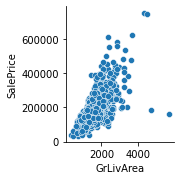

<seaborn.axisgrid.PairGrid at 0x7f21d6a95730>

In [0]:
sns.pairplot(data=df_raw_train_plt, x_vars= ['GrLivArea'], y_vars=['SalePrice'])
# From the plot we can see that there are two dots(GrLivArea>4000,SalePrice<300000) deviated from the general trend, so we deemed them as outliers.

In [0]:
# These are new houses with large area but only with low saleprice - outliers
display(df_raw_train.filter((col("SalePrice") < 300000) & (col('GrLivArea') > 4500)))

Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
524,60,RL,130,40094,Pave,NA,IR1,Bnk,AllPub,Inside,Gtl,Edwards,PosN,PosN,1Fam,2Story,10,5,2007,2008,Hip,CompShg,CemntBd,CmentBd,Stone,762,Ex,TA,PConc,Ex,TA,Gd,GLQ,2260,Unf,0,878,3138,GasA,Ex,Y,SBrkr,3138,1538,0,4676,1,0,3,1,3,1,Ex,11,Typ,1,Gd,BuiltIn,2007,Fin,3,884,TA,TA,Y,208,406,0,0,0,0,NA,NA,NA,0,10,2007,New,Partial,184750
1299,60,RL,313,63887,Pave,NA,IR3,Bnk,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,2Story,10,5,2008,2008,Hip,ClyTile,Stucco,Stucco,Stone,796,Ex,TA,PConc,Ex,TA,Gd,GLQ,5644,Unf,0,466,6110,GasA,Ex,Y,SBrkr,4692,950,0,5642,2,0,2,1,3,1,Ex,12,Typ,3,Gd,Attchd,2008,Fin,2,1418,TA,TA,Y,214,292,0,0,0,480,Gd,NA,NA,0,1,2008,New,Partial,160000


In [0]:
# delete these outliers
df_raw_train_clean = df_raw_train.filter((col("SalePrice") >= 300000) | (col('GrLivArea') <= 4500))

In [0]:
df_raw_train_clean.count()

Out[12]: 1458

## 1.2 Combine raw data

In [0]:
df_raw = df_raw_train_clean.unionByName(df_raw_test, allowMissingColumns=True)

In [0]:
df_raw.count()

Out[14]: 2917

In [0]:
display(df_raw.summary())

summary,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
count,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,2917,1458
mean,1460.3760713061365,57.13575591360987,null,69.18058412176059,10139.439149811451,null,null,null,null,null,null,null,null,null,null,null,null,6.086390126842646,5.564964004113816,1971.2879670894754,1984.2482002056909,null,null,null,null,null,101.73358673116793,null,null,null,null,null,null,null,439.0154320987654,null,49.61625514403292,560.695816186557,1049.3275034293554,null,null,null,null,1157.6924922865958,335.86150154268086,4.697634556050737,1498.2516283853274,0.42915951972555744,0.061406518010291594,1.5673637298594447,0.3798423037367158,2.860130270826191,1.0445663352759684,null,6.448063078505314,null,0.5961604388069934,null,null,1978.0920957215374,null,1.7661179698216736,472.40946502057614,null,null,null,93.62941378128214,47.280082276311276,23.114158381899212,2.604045251971203,16.073363044223516,2.0887898525882758,null,null,null,50.860815906753515,6.213575591360987,2007.7929379499485,null,null,180932.91906721535
stddev,842.892455891106,42.532140032613505,null,22.791718620660287,7807.03651203779,null,null,null,null,null,null,null,null,null,null,null,null,1.4067042210231424,1.1134141750701134,30.286990939675533,20.892256615929742,null,null,null,null,null,178.51029050031644,null,null,null,null,null,null,null,444.1823294389165,null,169.25866164499408,439.6516503434602,429.1059052884522,null,null,null,null,385.2642979499794,428.1196629824136,46.412569965272965,496.9086262977846,0.5240022845777815,0.24576595301983303,0.5524645576658223,0.5027819478238222,0.8229670363804511,0.2145323625300968,null,1.5642812542457383,null,0.64477348903744,null,null,25.57130044576835,null,0.7615305648315677,214.62087766955938,null,null,null,126.5326429744487,67.11896511146333,64.26342441741505,25.19671353976713,56.202054098399906,34.561370652329295,null,null,null,567.5951977135727,2.7130699262558298,1.3153278239881714,null,null,79495.05528474758
min,1,20,C (all),100,1300,Grvl,Grvl,IR1,Bnk,AllPub,Corner,Gtl,Blmngtn,Artery,Artery,1Fam,1.5Fin,1,1,1872,1950,Flat,CompShg,AsbShng,AsbShng,BrkCmn,0,Ex,Ex,BrkTil,Ex,Fa,Av,ALQ,0,ALQ,0,0,0,Floor,Ex,N,FuseA,334,0,0,334,0,0,0,0,0,0,Ex,2,Maj1,0,Ex,2Types,1895,Fin,0,0,Ex,Ex,N,0,0,0,0,0,0,Ex,GdPrv,Gar2,0,1,2006,COD,Abnorml,34900
25%,731,20,null,59.0,7476,null,null,null,null,null,null,null,null,null,null,null,null,5,5,1953,1965,null,null,null,null,null,0.0,null,null,null,null,null,null,null,0.0,null,0.0,220.0,793.0,null,null,null,null,876,0,0,1126,0.0,0.0,1,0,2,1,null,5,null,0,null,null,1960.0,null,1.0,320.0,null,null,null,0,0,0,0,0,0,null,null,null,0,4,2007,null,null,129900
50%,1461,50,null,68.0,9452,null,null,null,null,null,null,null,null,null,null,null,null,6,5,1973,1993,null,null,null,null,null,0.0,null,null,null,null,null,null,null,368.0,null,0.0,467.0,988.0,nu

In [0]:
display(df_raw)

Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,60,RL,65,8450,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NA,Attchd,2003,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NA,NA,NA,0,2,2008,WD,Normal,208500
2,20,RL,80,9600,Pave,NA,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NA,NA,NA,0,5,2007,WD,Normal,181500
3,60,RL,68,11250,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NA,NA,NA,0,9,2008,WD,Normal,223500
4,70,RL,60,9550,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NA,NA,NA,0,2,2006,WD,Abnorml,140000
5,60,RL,84,14260,Pave,NA,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NA,NA,NA,0,12,2008,WD,Normal,250000
6,50,RL,85,14115,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NA,Attchd,1993,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NA,MnPrv,Shed,700,10,2009,WD,Normal,143000
7,20,RL,75,10084,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NA,NA,NA,0,8,2007,WD,Normal,307000
8,60,RL,NA,10382,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NA,NA,Shed,350,11,2009,WD,Normal,200000
9,50,RM,51,6120,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NA,NA,NA,0,4,2008,WD,Abnorml,129900
10,190,RL,50,7420,Pave,NA,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,GasA,Ex,Y,SBrkr,1077,0,0,1077,1,0,1,0,2,2,TA,5,Typ,2,TA,Attchd,1939,RFn,1,205,Gd,TA,Y,0,4,0,0,0,0,NA,NA,NA,0,1,2008,W

In [0]:
df_raw.printSchema()

root
-- Id: integer (nullable = true)
-- MSSubClass: integer (nullable = true)
-- MSZoning: string (nullable = true)
-- LotFrontage: string (nullable = true)
-- LotArea: integer (nullable = true)
-- Street: string (nullable = true)
-- Alley: string (nullable = true)
-- LotShape: string (nullable = true)
-- LandContour: string (nullable = true)
-- Utilities: string (nullable = true)
-- LotConfig: string (nullable = true)
-- LandSlope: string (nullable = true)
-- Neighborhood: string (nullable = true)
-- Condition1: string (nullable = true)
-- Condition2: string (nullable = true)
-- BldgType: string (nullable = true)
-- HouseStyle: string (nullable = true)
-- OverallQual: integer (nullable = true)
-- OverallCond: integer (nullable = true)
-- YearBuilt: integer (nullable = true)
-- YearRemodAdd: integer (nullable = true)
-- RoofStyle: string (nullable = true)
-- RoofMatl: string (nullable = true)
-- Exterior1st: string (nullable = true)
-- Exterior2nd: string (nullable = true)
-- MasVnrType: string (nullable = true)
-- MasVnrArea: string (nullable = true)
-- ExterQual: string (nullable = true)
-- ExterCond: string (nullable = true)
-- Foundation: string (nullable = true)
-- BsmtQual: string (nullable = true)
-- BsmtCond: string (nullable = true)
-- BsmtExposure: string (nullable = true)
-- BsmtFinType1: string (nullable = true)
-- BsmtFinSF1: string (nullable = true)
-- BsmtFinType2: string (nullable = true)
-- BsmtFinSF2: string (nullable = true)
-- BsmtUnfSF: string (nullable = true)
-- TotalBsmtSF: string (nullable = true)
-- Heating: string (nullable = true)
-- HeatingQC: string (nullable = true)
-- CentralAir: string (nullable = true)
-- Electrical: string (nullable = true)
-- 1stFlrSF: integer (nullable = true)
-- 2ndFlrSF: integer (nullable = true)
-- LowQualFinSF: integer (nullable = true)
-- GrLivArea: integer (nullable = true)
-- BsmtFullBath: string (nullable = true)
-- BsmtHalfBath: string (nullable = true)
-- FullBath: integer (nullable = true)
-- HalfBath: integer (nullable = true)
-- BedroomAbvGr: integer (nullable = true)
-- KitchenAbvGr: integer (nullable = true)
-- KitchenQual: string (nullable = true)
-- TotRmsAbvGrd: integer (nullable = true)
-- Functional: string (nullable = true)
-- Fireplaces: integer (nullable = true)
-- FireplaceQu: string (nullable = true)
-- GarageType: string (nullable = true)
-- GarageYrBlt: string (nullable = true)
-- GarageFinish: string (nullable = true)
-- GarageCars: string (nullable = true)
-- GarageArea: string (nullable = true)
-- GarageQual: string (nullable = true)
-- GarageCond: string (nullable = true)
-- PavedDrive: string (nullable = true)
-- WoodDeckSF: integer (nullable = true)
-- OpenPorchSF: integer (nullable = true)
-- EnclosedPorch: integer (nullable = true)
-- 3SsnPorch: integer (nullable = true)
-- ScreenPorch: integer (nullable = true)
-- PoolArea: integer (nullable = true)
-- PoolQC: string (nullable = true)
-- Fence: string (nullable = true)
-- MiscFeature: string (nullable = true)
-- MiscVal: integer (nullable = true)
-- MoSold: integer (nullable = true)
-- YrSold: integer (nullable = true)
-- SaleType: string (nullable = true)
-- SaleCondition: string (nullable = true)
-- SalePrice: integer (nullable = true)

## 1.3 Wrong data type transformation

In [0]:
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df

df_raw_clean = string_to_double(df_raw, ["LotFrontage","MasVnrArea","BsmtFinSF1","BsmtFinSF2","BsmtUnfSF","TotalBsmtSF","BsmtFullBath","BsmtHalfBath","GarageYrBlt","GarageCars","GarageArea"])

In [0]:
def int_to_string(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("string"))
    return df
    
df_raw_clean = int_to_string(df_raw_clean, ["MSSubClass","MoSold"])

In [0]:
display(df_raw_clean)

Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,60,RL,65.0,8450,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706.0,Unf,0.0,150.0,856.0,GasA,Ex,Y,SBrkr,856,854,0,1710,1.0,0.0,2,1,3,1,Gd,8,Typ,0,NA,Attchd,2003.0,RFn,2.0,548.0,TA,TA,Y,0,61,0,0,0,0,NA,NA,NA,0,2,2008,WD,Normal,208500
2,20,RL,80.0,9600,Pave,NA,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0,Unf,0.0,284.0,1262.0,GasA,Ex,Y,SBrkr,1262,0,0,1262,0.0,1.0,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2.0,460.0,TA,TA,Y,298,0,0,0,0,0,NA,NA,NA,0,5,2007,WD,Normal,181500
3,60,RL,68.0,11250,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0,Unf,0.0,434.0,920.0,GasA,Ex,Y,SBrkr,920,866,0,1786,1.0,0.0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2.0,608.0,TA,TA,Y,0,42,0,0,0,0,NA,NA,NA,0,9,2008,WD,Normal,223500
4,70,RL,60.0,9550,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0,Unf,0.0,540.0,756.0,GasA,Gd,Y,SBrkr,961,756,0,1717,1.0,0.0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3.0,642.0,TA,TA,Y,0,35,272,0,0,0,NA,NA,NA,0,2,2006,WD,Abnorml,140000
5,60,RL,84.0,14260,Pave,NA,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0,Unf,0.0,490.0,1145.0,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1.0,0.0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3.0,836.0,TA,TA,Y,192,84,0,0,0,0,NA,NA,NA,0,12,2008,WD,Normal,250000
6,50,RL,85.0,14115,Pave,NA,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732.0,Unf,0.0,64.0,796.0,GasA,Ex,Y,SBrkr,796,566,0,1362,1.0,0.0,1,1,1,1,TA,5,Typ,0,NA,Attchd,1993.0,Unf,2.0,480.0,TA,TA,Y,40,30,0,320,0,0,NA,MnPrv,Shed,700,10,2009,WD,Normal,143000
7,20,RL,75.0,10084,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369.0,Unf,0.0,317.0,1686.0,GasA,Ex,Y,SBrkr,1694,0,0,1694,1.0,0.0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2.0,636.0,TA,TA,Y,255,57,0,0,0,0,NA,NA,NA,0,8,2007,WD,Normal,307000
8,60,RL,null,10382,Pave,NA,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859.0,BLQ,32.0,216.0,1107.0,GasA,Ex,Y,SBrkr,1107,983,0,2090,1.0,0.0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2.0,484.0,TA,TA,Y,235,204,228,0,0,0,NA,NA,Shed,350,11,2009,WD,Normal,200000
9,50,RM,51.0,6120,Pave,NA,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0.0,Unf,0.0,952.0,952.0,GasA,Gd,Y,FuseF,1022,752,0,1774,0.0,0.0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2.0,468.0,Fa,TA,Y,90,0,205,0,0,0,NA,NA,NA,0,4,2008,WD,Abnorml,129900
10,190,RL,50.0,7420,Pave,NA,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,195

In [0]:
df_raw_clean.printSchema()

root
-- Id: integer (nullable = true)
-- MSSubClass: string (nullable = true)
-- MSZoning: string (nullable = true)
-- LotFrontage: double (nullable = true)
-- LotArea: integer (nullable = true)
-- Street: string (nullable = true)
-- Alley: string (nullable = true)
-- LotShape: string (nullable = true)
-- LandContour: string (nullable = true)
-- Utilities: string (nullable = true)
-- LotConfig: string (nullable = true)
-- LandSlope: string (nullable = true)
-- Neighborhood: string (nullable = true)
-- Condition1: string (nullable = true)
-- Condition2: string (nullable = true)
-- BldgType: string (nullable = true)
-- HouseStyle: string (nullable = true)
-- OverallQual: integer (nullable = true)
-- OverallCond: integer (nullable = true)
-- YearBuilt: integer (nullable = true)
-- YearRemodAdd: integer (nullable = true)
-- RoofStyle: string (nullable = true)
-- RoofMatl: string (nullable = true)
-- Exterior1st: string (nullable = true)
-- Exterior2nd: string (nullable = true)
-- MasVnrType: string (nullable = true)
-- MasVnrArea: double (nullable = true)
-- ExterQual: string (nullable = true)
-- ExterCond: string (nullable = true)
-- Foundation: string (nullable = true)
-- BsmtQual: string (nullable = true)
-- BsmtCond: string (nullable = true)
-- BsmtExposure: string (nullable = true)
-- BsmtFinType1: string (nullable = true)
-- BsmtFinSF1: double (nullable = true)
-- BsmtFinType2: string (nullable = true)
-- BsmtFinSF2: double (nullable = true)
-- BsmtUnfSF: double (nullable = true)
-- TotalBsmtSF: double (nullable = true)
-- Heating: string (nullable = true)
-- HeatingQC: string (nullable = true)
-- CentralAir: string (nullable = true)
-- Electrical: string (nullable = true)
-- 1stFlrSF: integer (nullable = true)
-- 2ndFlrSF: integer (nullable = true)
-- LowQualFinSF: integer (nullable = true)
-- GrLivArea: integer (nullable = true)
-- BsmtFullBath: double (nullable = true)
-- BsmtHalfBath: double (nullable = true)
-- FullBath: integer (nullable = true)
-- HalfBath: integer (nullable = true)
-- BedroomAbvGr: integer (nullable = true)
-- KitchenAbvGr: integer (nullable = true)
-- KitchenQual: string (nullable = true)
-- TotRmsAbvGrd: integer (nullable = true)
-- Functional: string (nullable = true)
-- Fireplaces: integer (nullable = true)
-- FireplaceQu: string (nullable = true)
-- GarageType: string (nullable = true)
-- GarageYrBlt: double (nullable = true)
-- GarageFinish: string (nullable = true)
-- GarageCars: double (nullable = true)
-- GarageArea: double (nullable = true)
-- GarageQual: string (nullable = true)
-- GarageCond: string (nullable = true)
-- PavedDrive: string (nullable = true)
-- WoodDeckSF: integer (nullable = true)
-- OpenPorchSF: integer (nullable = true)
-- EnclosedPorch: integer (nullable = true)
-- 3SsnPorch: integer (nullable = true)
-- ScreenPorch: integer (nullable = true)
-- PoolArea: integer (nullable = true)
-- PoolQC: string (nullable = true)
-- Fence: string (nullable = true)
-- MiscFeature: string (nullable = true)
-- MiscVal: integer (nullable = true)
-- MoSold: string (nullable = true)
-- YrSold: integer (nullable = true)
-- SaleType: string (nullable = true)
-- SaleCondition: string (nullable = true)
-- SalePrice: integer (nullable = true)

## 1.4 Handle missing value

In [0]:
# column names with the string "NA"
col_withNA = list()
for c in df_raw_clean.columns:
    if df_raw_clean.filter(col(c)=="NA").count() != 0:
        col_withNA.append(c)
col_withNA # some "NA" can be seen as the specific labels but not the true missing values in some of the variables

Out[22]: ['MSZoning',
 'Alley',
 'Utilities',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinType2',
 'Electrical',
 'KitchenQual',
 'Functional',
 'FireplaceQu',
 'GarageType',
 'GarageFinish',
 'GarageQual',
 'GarageCond',
 'PoolQC',
 'Fence',
 'MiscFeature',
 'SaleType']

In [0]:
len(col_withNA)

Out[23]: 23

### 1.4.1 Fill `Bsmt` and `Garage` related numerical varibales with 0

In [0]:
df_raw_clean = df_raw_clean.na.fill(value=0, subset=["BsmtFinSF1","BsmtFinSF2","BsmtUnfSF","TotalBsmtSF","BsmtFullBath","BsmtHalfBath","GarageCars","GarageArea"])

# `GarageYrBlt` will be handled with in 1.6.1

### 1.4.2 Fill `LotFrontage` with bag (done in 1.7)

### 1.4.3 Fill other varibales with mode

In [0]:
def fill_mode(df_fill, df_mode, colname, to_replace):
    mode_value = df_mode.select(colname).groupBy(colname).count().orderBy("count").tail(1)[0][0]
    df_fill = df_fill.replace(to_replace, mode_value, subset=[colname])
    return df_fill

#### `MasVnrType` & `MasVnrArea`

In [0]:
# MasVnrType & MasVnrArea: fill MasVnrType with mode="None" so fill MasVnrArea with 0
df_raw_clean = fill_mode(df_raw_clean, df_raw_clean, "MasVnrType", "NA")

In [0]:
df_raw_clean.select("MasVnrType").groupBy("MasVnrType").count().orderBy("count").show()

+----------+-----+
MasVnrType|count|
+----------+-----+
 BrkCmn| 25|
 Stone| 247|
 BrkFace| 879|
 None| 1766|
+----------+-----+

In [0]:
df_raw_clean = df_raw_clean.na.fill(value=0, subset=["MasVnrArea"])

#### `Electrical` & `Functional` & `MSZoning` & `Utilities`

In [0]:
# Electrical: fill with mode
df_raw_clean = fill_mode(df_raw_clean, df_raw_clean, "Electrical", "NA")

In [0]:
# Functional: fill with mode
df_raw_clean = fill_mode(df_raw_clean, df_raw_clean, "Functional", "NA")

In [0]:
# MSZoning: fill with mode
df_raw_clean = fill_mode(df_raw_clean, df_raw_clean, "MSZoning", "NA")

In [0]:
# Utilities: fill with mode
df_raw_clean = fill_mode(df_raw_clean, df_raw_clean, "Utilities", "NA")

#### `KitchenQual`

In [0]:
# KitchenQual: fill with the mode of the entry with the same KitchenAbvGr
df_raw_clean.select("KitchenAbvGr").where(col("KitchenQual")=="NA").show()

+------------+
KitchenAbvGr|
+------------+
 1|
+------------+

In [0]:
corresponing = df_raw_clean.select("KitchenAbvGr").where(col("KitchenQual")=="NA").collect()[0][0]
df_kitchen_NA = df_raw_clean.select("KitchenQual").where(col("KitchenAbvGr")==corresponing)
df_raw_clean = fill_mode(df_raw_clean, df_kitchen_NA, "KitchenQual", "NA")

#### `SaleType`

In [0]:
# SaleType: fill with the mode of the entry with the same SaleCondition
df_raw_clean.select("SaleCondition").where(col("SaleType")=="NA").show()

+-------------+
SaleCondition|
+-------------+
 Normal|
+-------------+

In [0]:
corresponing = df_raw_clean.select("SaleCondition").where(col("SaleType")=="NA").collect()[0][0]
df_saletype_NA = df_raw_clean.select("SaleType").where(col("SaleCondition")==corresponing)
df_raw_clean = fill_mode(df_raw_clean, df_saletype_NA, "SaleType", "NA")

#### `Exterior1st` & `Exterior2nd`

In [0]:
# Exterior1st & Exterior2nd: fill with the mode of the entry with the same ExterQual & ExterCond
df_raw_clean.select("Id").where(col("Exterior1st")=="NA").show()
df_raw_clean.select("Id").where(col("Exterior2nd")=="NA").show() # missing value is on the same row

+----+
 Id|
+----+
2152|
+----+

+----+
 Id|
+----+
2152|
+----+

In [0]:
df_raw_clean.select("ExterQual", "ExterCond").where(col("Exterior1st")=="NA").show()

+---------+---------+
ExterQual|ExterCond|
+---------+---------+
 TA| TA|
+---------+---------+

In [0]:
corresponing_eq = df_raw_clean.select("ExterQual", "ExterCond").where(col("Exterior1st")=="NA").collect()[0][0]
corresponing_ec = df_raw_clean.select("ExterQual", "ExterCond").where(col("Exterior1st")=="NA").collect()[0][1]
df_Exterior1st_NA = df_raw_clean.select("Exterior1st").where((col("ExterQual")==corresponing_eq)&(col("ExterCond")==corresponing_ec))
df_raw_clean = fill_mode(df_raw_clean, df_Exterior1st_NA, "Exterior1st", "NA")

In [0]:
corresponing_eq = df_raw_clean.select("ExterQual", "ExterCond").where(col("Exterior2nd")=="NA").collect()[0][0]
corresponing_ec = df_raw_clean.select("ExterQual", "ExterCond").where(col("Exterior2nd")=="NA").collect()[0][1]
df_Exterior2nd_NA = df_raw_clean.select("Exterior2nd").where((col("ExterQual")==corresponing_eq)&(col("ExterCond")==corresponing_ec))
df_raw_clean = fill_mode(df_raw_clean, df_Exterior2nd_NA, "Exterior2nd", "NA")

## 1.5 Typo correction

### 1.5.1 `Garage` related

In [0]:
# typo: GarageYrBlt=2207 -> 2007
df_raw_clean = df_raw_clean.replace(2207, 2007, subset=["GarageYrBlt"])

In [0]:
# typo: GarageType != NA but GarageFinish == NA
df_raw_clean.select("Id","GarageType","GarageYrBlt","GarageFinish","GarageCars","GarageArea","GarageQual","GarageCond").where((col("GarageFinish")=="NA")&(col("GarageType")!="NA")).show()

+----+----------+-----------+------------+----------+----------+----------+----------+
 Id|GarageType|GarageYrBlt|GarageFinish|GarageCars|GarageArea|GarageQual|GarageCond|
+----+----------+-----------+------------+----------+----------+----------+----------+
2127| Detchd| null| NA| 1.0| 360.0| NA| NA|
2577| Detchd| null| NA| 0.0| 0.0| NA| NA|
+----+----------+-----------+------------+----------+----------+----------+----------+

In [0]:
# for 2nd typo row: Id=2577
# since most of garage related features are 0 or NA, we simply repalce GarageType with NA
df_raw_clean = df_raw_clean.withColumn("GarageType", \
               when((col("GarageFinish")=="NA")&(col("GarageType")!="NA")&(col("GarageCars")==0), "NA")\
                                       .otherwise(df_raw_clean['GarageType']))

In [0]:
# for 1st typo row: Id=2127
# let's fisrt look at the correlation of these features

# convert sparkdataframe to pandas dataframe to do visualization
df_raw_plt = df_raw_clean.toPandas()

Out[45]:

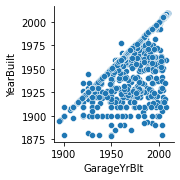

<seaborn.axisgrid.PairGrid at 0x7f21d40dba60>

In [0]:
# There is a correlation between 'GarageYrBlt' and 'YearBuilt'. So we can use YearBuilt to infer GarageYrBlt.
sns.pairplot(data=df_raw_plt, x_vars=['GarageYrBlt'], y_vars=['YearBuilt'])

Out[46]:

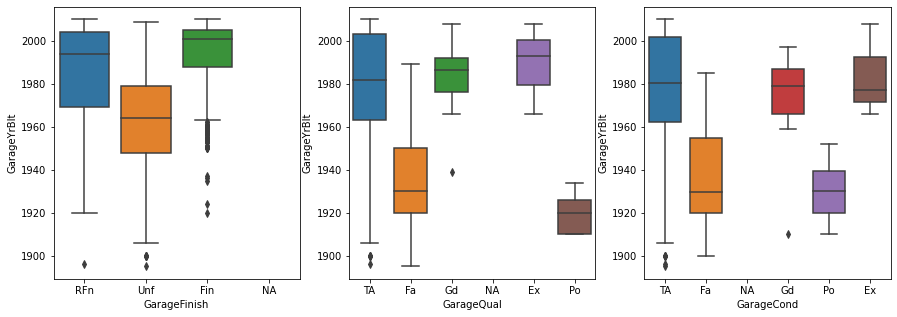

<AxesSubplot:xlabel='GarageCond', ylabel='GarageYrBlt'>

In [0]:
# The correlation bewteen GarageFinish&GarageYrBlt, GarageQual&GarageYrBlt, GarageCond&GarageYrBlt.
f, axes = plt.subplots(1, 3, figsize=(15,5))
sns.boxplot(x=df_raw_plt['GarageFinish'], y=df_raw_plt['GarageYrBlt'], data=df_raw_plt,ax=axes[0])
sns.boxplot(x=df_raw_plt['GarageQual'], y=df_raw_plt['GarageYrBlt'], data=df_raw_plt,ax=axes[1])
sns.boxplot(x=df_raw_plt['GarageCond'], y=df_raw_plt['GarageYrBlt'],data=df_raw_plt,ax=axes[2])

In [0]:
# Assume: GarageYrBlt <- YearBuilt
df_raw_clean = df_raw_clean.withColumn("GarageYrBlt", \
               when(col("Id")==2127, df_raw_clean['YearBuilt'])\
                                       .otherwise(df_raw_clean['GarageYrBlt']))

# Assume: GarageFinish, GarageQual, GarageCond <- mode with the same GarageYrBlt
corresponing = df_raw_clean.select("GarageYrBlt").where(col("Id")==2127).collect()[0][0]

df_garage_NA = df_raw_clean.select("GarageFinish").where(col("GarageYrBlt")==int(corresponing))
mode_value = df_garage_NA.select("GarageFinish").groupBy("GarageFinish").count().orderBy("count").tail(1)[0][0]
df_raw_clean = df_raw_clean.withColumn("GarageFinish", \
               when(col("Id")==2127, mode_value)\
                                       .otherwise(df_raw_clean['GarageFinish']))

df_garage_NA = df_raw_clean.select("GarageQual").where(col("GarageYrBlt")==int(corresponing))
mode_value = df_garage_NA.select("GarageQual").groupBy("GarageQual").count().orderBy("count").tail(1)[0][0]
df_raw_clean = df_raw_clean.withColumn("GarageQual", \
               when(col("Id")==2127, mode_value)\
                                       .otherwise(df_raw_clean['GarageQual']))

df_garage_NA = df_raw_clean.select("GarageCond").where(col("GarageYrBlt")==int(corresponing))
mode_value = df_garage_NA.select("GarageCond").groupBy("GarageCond").count().orderBy("count").tail(1)[0][0]
df_raw_clean = df_raw_clean.withColumn("GarageCond", \
               when(col("Id")==2127, mode_value)\
                                       .otherwise(df_raw_clean['GarageCond']))

### 1.5.2 `MasVnr` related

In [0]:
# typo: MasVnrType='None' but MasVnrArea=1
# since 1 is quite small, so MasVnrArea=1 -> 0
df_raw_clean = df_raw_clean.withColumn("MasVnrArea", \
               when((df_raw_clean['MasVnrType']=='None')&(df_raw_clean['MasVnrArea']==1), 0)\
                                       .otherwise(df_raw_clean['MasVnrArea']))

In [0]:
# typo: MasVnrType='None' but MasVnrArea = a large value 
# MasVnrType-> second mode since first mode is None
second_mode = df_raw_clean.select("MasVnrType").groupBy("MasVnrType").count().orderBy("count").tail(2)[0][0]
df_raw_clean = df_raw_clean.withColumn("MasVnrType", \
               when((df_raw_clean['MasVnrType']=='None')&(df_raw_clean['MasVnrArea'] > 1), second_mode)\
                                       .otherwise(df_raw_clean['MasVnrType']))

### 1.5.3 `Bsmt` related

In [0]:
# transform the string value of GarageQual to integer to do boxplot
df_raw_plt['BsmtQual'].replace('Ex',6,inplace=True)
df_raw_plt['BsmtQual'].replace('Gd',5,inplace=True)
df_raw_plt['BsmtQual'].replace('TA',4,inplace=True)
df_raw_plt['BsmtQual'].replace('Fa',3,inplace=True)
df_raw_plt['BsmtQual'].replace('Po',2,inplace=True)
df_raw_plt['BsmtQual'].replace('NA',1,inplace=True)

Out[51]:

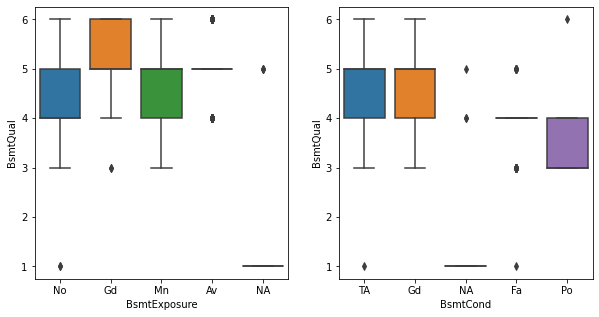

<AxesSubplot:xlabel='BsmtCond', ylabel='BsmtQual'>

In [0]:
# The correlation between BsmtExposure&BsmtQual, BsmtCond&BsmtQual
f, axes = plt.subplots(1, 2, figsize=(10,5))
sns.boxplot(x=df_raw_plt['BsmtExposure'], y=df_raw_plt['BsmtQual'],data=df_raw_plt,ax=axes[0])
sns.boxplot(x=df_raw_plt['BsmtCond'], y=df_raw_plt['BsmtQual'],data=df_raw_plt,ax=axes[1])

In [0]:
df_raw_clean.select("BsmtQual").where((col("BsmtExposure")=="NA")&(col("BsmtQual")!="NA")).collect() # all are "Gd"

Out[52]: [Row(BsmtQual='Gd'), Row(BsmtQual='Gd'), Row(BsmtQual='Gd')]

In [0]:
# typo: BsmtExposure="NA" but other Bsmt related != "NA"
# since BsmtExposure is correlated with BsmtQual, fill BsmtExposure with the mode of the entry with the same BsmtQual
corresponing = df_raw_clean.select("BsmtQual").where((col("BsmtExposure")=="NA")&(col("BsmtQual")!="NA")).collect()[0][0]
df_Bsmt_NA = df_raw_clean.select("BsmtExposure").where(col("BsmtQual")==corresponing)
mode_value = df_Bsmt_NA.select("BsmtExposure").groupBy("BsmtExposure").count().orderBy("count").tail(1)[0][0]

df_raw_clean = df_raw_clean.withColumn("BsmtExposure", \
               when((df_raw_clean['BsmtExposure']=='NA')&(df_raw_clean['BsmtQual']!="NA"), mode_value)\
                                       .otherwise(df_raw_clean['BsmtExposure']))

In [0]:
df_raw_clean.select("BsmtFinType1").where((col("BsmtFinType2")=="NA")&(col("BsmtFinSF2")!=0)).collect()

Out[54]: [Row(BsmtFinType1='GLQ')]

In [0]:
# typo: BsmtFinType2="NA" but other Bsmt related != "NA"
# fill BsmtFinType2 with the mode of the entry with the same BsmtFinType1
corresponing = df_raw_clean.select("BsmtFinType1").where((col("BsmtFinType2")=="NA")&(col("BsmtFinSF2")!=0)).collect()[0][0]
df_Bsmt_NA = df_raw_clean.select("BsmtFinType2").where(col("BsmtFinType1")==corresponing)
mode_value = df_Bsmt_NA.select("BsmtFinType2").groupBy("BsmtFinType2").count().orderBy("count").tail(1)[0][0]

df_raw_clean = df_raw_clean.withColumn("BsmtFinType2", \
               when((col("BsmtFinType2")=="NA")&(col("BsmtFinSF2")!=0), mode_value)\
                                       .otherwise(df_raw_clean['BsmtFinType2']))

In [0]:
# typo: BsmtQual="NA" but other Bsmt related != "NA"
# fill BsmtQual with the mode of the entry with the same BsmtExposure
df_raw_clean.select("BsmtExposure").where((col("BsmtQual")=="NA")&(col("BsmtCond")!="NA")).show() # all are No

+------------+
BsmtExposure|
+------------+
 No|
 No|
+------------+

In [0]:
corresponing = df_raw_clean.select("BsmtExposure").where((col("BsmtQual")=="NA")&(col("BsmtCond")!="NA")).collect()[0][0]
df_Bsmt_NA = df_raw_clean.select("BsmtQual").where(col("BsmtExposure")==corresponing)
mode_value = df_Bsmt_NA.select("BsmtQual").groupBy("BsmtQual").count().orderBy("count").tail(1)[0][0]

df_raw_clean = df_raw_clean.withColumn("BsmtQual", \
               when((col("BsmtQual")=="NA")&(col("BsmtCond")!="NA"), mode_value)\
                                       .otherwise(df_raw_clean['BsmtQual']))

In [0]:
# typo: BsmtCond="NA" but other Bsmt related != "NA"
# since BsmtCond is correlated with BsmtQual, fill BsmtCond with the mode of the entry with the same BsmtQual
df_raw_clean.select("BsmtQual").where((col("BsmtQual")!="NA")&(col("BsmtCond")=="NA")).show()

+--------+
BsmtQual|
+--------+
 Gd|
 TA|
 TA|
+--------+

In [0]:
corresponing = df_raw_clean.select("BsmtQual").where((col("BsmtQual")!="NA")&(col("BsmtCond")=="NA")).collect()[0][0] # "Gd"
df_Bsmt_NA = df_raw_clean.select("BsmtCond").where(col("BsmtQual")==corresponing)
mode_value = df_Bsmt_NA.select("BsmtCond").groupBy("BsmtCond").count().orderBy("count").tail(1)[0][0]

df_raw_clean = df_raw_clean.withColumn("BsmtCond", \
               when((col("BsmtQual")==corresponing)&(col("BsmtCond")=="NA"), mode_value)\
                                       .otherwise(df_raw_clean['BsmtCond']))

corresponing = df_raw_clean.select("BsmtQual").where((col("BsmtQual")!="NA")&(col("BsmtCond")=="NA")).collect()[1][0] # "TA"
df_Bsmt_NA = df_raw_clean.select("BsmtCond").where(col("BsmtQual")==corresponing)
mode_value = df_Bsmt_NA.select("BsmtCond").groupBy("BsmtCond").count().orderBy("count").tail(1)[0][0]

df_raw_clean = df_raw_clean.withColumn("BsmtCond", \
               when((col("BsmtQual")==corresponing)&(col("BsmtCond")=="NA"), mode_value)\
                                       .otherwise(df_raw_clean['BsmtCond']))

### 1.5.4 Fill remaining "NA" with "Non" in case misunderstanding

In [0]:
df_raw_clean = df_raw_clean.replace("NA","Non", subset=["Alley","BsmtQual","BsmtCond","BsmtExposure","BsmtFinType1","BsmtFinType2","FireplaceQu","GarageType","GarageFinish","GarageQual","GarageCond","PoolQC","Fence","MiscFeature"])

## 1.6 New feature creation

### 1.6.1 Year related

In [0]:
df_raw_clean = df_raw_clean.withColumn("DurBuilt", col("YrSold")-col("YearBuilt"))
df_raw_clean = df_raw_clean.withColumn("DurRemodAdd", col("YrSold")-col("YearRemodAdd"))
df_raw_clean = df_raw_clean.withColumn("DurGarageBlt", col("YrSold")-col("GarageYrBlt"))

In [0]:
# fill the missing value of DurGarageBlt which represents no garage with a large enough value
df_raw_clean.agg({"DurGarageBlt": "max"}).collect() # It's large enough to fill na with 200
df_raw_clean = df_raw_clean.na.fill(value=200, subset=["DurGarageBlt"])

### 1.6.2 Area related

In [0]:
# Average size of each room above ground
df_raw_clean = df_raw_clean.withColumn("AvgRmAbvGrd", col("GrLivArea")/(col("TotRmsAbvGrd")+col("FullBath")+col("HalfBath")))
# Total Area of the house
df_raw_clean = df_raw_clean.withColumn("TotalArea", col("GrLivArea")+col("TotalBsmtSF"))

In [0]:
display(df_raw_clean) # You can download the csv file named "export_SparktoR_combine.csv" and import it on "/FileStore/final data/export_SparktoR_combine.csv" by yourself (Or, Use files that have been uploaded in DBFS）

Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,DurBuilt,DurRemodAdd,DurGarageBlt,AvgRmAbvGrd,TotalArea
1,60,RL,65.0,8450,Pave,Non,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706.0,Unf,0.0,150.0,856.0,GasA,Ex,Y,SBrkr,856,854,0,1710,1.0,0.0,2,1,3,1,Gd,8,Typ,0,Non,Attchd,2003.0,RFn,2.0,548.0,TA,TA,Y,0,61,0,0,0,0,Non,Non,Non,0,2,2008,WD,Normal,208500,5,5,5.0,155.45454545454547,2566.0
2,20,RL,80.0,9600,Pave,Non,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0,Unf,0.0,284.0,1262.0,GasA,Ex,Y,SBrkr,1262,0,0,1262,0.0,1.0,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2.0,460.0,TA,TA,Y,298,0,0,0,0,0,Non,Non,Non,0,5,2007,WD,Normal,181500,31,31,31.0,157.75,2524.0
3,60,RL,68.0,11250,Pave,Non,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0,Unf,0.0,434.0,920.0,GasA,Ex,Y,SBrkr,920,866,0,1786,1.0,0.0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2.0,608.0,TA,TA,Y,0,42,0,0,0,0,Non,Non,Non,0,9,2008,WD,Normal,223500,7,6,7.0,198.44444444444446,2706.0
4,70,RL,60.0,9550,Pave,Non,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0,Unf,0.0,540.0,756.0,GasA,Gd,Y,SBrkr,961,756,0,1717,1.0,0.0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3.0,642.0,TA,TA,Y,0,35,272,0,0,0,Non,Non,Non,0,2,2006,WD,Abnorml,140000,91,36,8.0,214.625,2473.0
5,60,RL,84.0,14260,Pave,Non,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0,Unf,0.0,490.0,1145.0,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1.0,0.0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3.0,836.0,TA,TA,Y,192,84,0,0,0,0,Non,Non,Non,0,12,2008,WD,Normal,250000,8,8,8.0,183.16666666666666,3343.0
6,50,RL,85.0,14115,Pave,Non,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732.0,Unf,0.0,64.0,796.0,GasA,Ex,Y,SBrkr,796,566,0,1362,1.0,0.0,1,1,1,1,TA,5,Typ,0,Non,Attchd,1993.0,Unf,2.0,480.0,TA,TA,Y,40,30,0,320,0,0,Non,MnPrv,Shed,700,10,2009,WD,Normal,143000,16,14,16.0,194.57142857142858,2158.0
7,20,RL,75.0,10084,Pave,Non,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369.0,Unf,0.0,317.0,1686.0,GasA,Ex,Y,SBrkr,1694,0,0,1694,1.0,0.0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2.0,636.0,TA,TA,Y,255,57,0,0,0,0,Non,Non,Non,0,8,2007,WD,Normal,307000,3,2,3.0,188.22222222222223,3380.0
8,60,RL,null,10382,Pave,Non,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859.0,BLQ,32.0,216.0,1107.0,GasA,Ex,Y,SBrkr,1107,983,0,2090,1.0,0.0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2.0,484.0,TA,TA,Y,235,204,228,0,0,0,Non,Non,Shed,350,11,2009,WD,Normal,200000,36,36,36.0,209.0,3197.0
9,50,RM,51.0,6120,Pave,Non,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,

## 1.7 Use R to do the following preprocessing

### 1.7.1 Transform data type

In [0]:
%r 
library(SparkR)
df_raw_clean_sparkr <- read.df("/FileStore/final data/export_SparktoR_combine.csv", source = "csv", header="true", inferSchema = "true") # You can download the csv file named "export_SparktoR_combine.csv" on cmd 86 and import it on DBFS by yourself (Or, just use files that have already been uploaded in DBFS）

df_raw_clean_r <- as.data.frame(df_raw_clean_sparkr)
str(df_raw_clean_r) # need to transform some data type

Attaching package: ‘SparkR’

The following object is masked _by_ ‘.GlobalEnv’:

 setLocalProperty

The following objects are masked from ‘package:stats’:

 cov, filter, lag, na.omit, predict, sd, var, window

The following objects are masked from ‘package:base’:

 as.data.frame, colnames, colnames<-, drop, endsWith, intersect,
 rank, rbind, sample, startsWith, subset, summary, transform, union

'data.frame':	2917 obs. of 86 variables:
 $ Id : int 1 2 3 4 5 6 7 8 9 10 ...
 $ MSSubClass : int 60 20 60 70 60 50 20 60 50 190 ...
 $ MSZoning : chr "RL" "RL" "RL" "RL" ...
 $ LotFrontage : chr "65.0" "80.0" "68.0" "60.0" ...
 $ LotArea : int 8450 9600 11250 9550 14260 14115 10084 10382 6120 7420 ...
 $ Street : chr "Pave" "Pave" "Pave" "Pave" ...
 $ Alley : chr "Non" "Non" "Non" "Non" ...
 $ LotShape : chr "Reg" "Reg" "IR1" "IR1" ...
 $ LandContour : chr "Lvl" "Lvl" "Lvl" "Lvl" ...
 $ Utilities : chr "AllPub" "AllPub" "AllPub" "AllPub" ...
 $ LotConfig : chr "Inside" "FR2" "Inside" "Corner" ...
 $ LandSlope : chr "Gtl" "Gtl" "Gtl" "Gtl" ...
 $ Neighborhood : chr "CollgCr" "Veenker" "CollgCr" "Crawfor" ...
 $ Condition1 : chr "Norm" "Feedr" "Norm" "Norm" ...
 $ Condition2 : chr "Norm" "Norm" "Norm" "Norm" ...
 $ BldgType : chr "1Fam" "1Fam" "1Fam" "1Fam" ...
 $ HouseStyle : chr "2Story" "1Story" "2Story" "2Story" ...
 $ OverallQual : int 7 6 7 7 8 5 8 7 7 5 ...
 $ OverallCond : int 5 8 5 5 5 5 5 6 5 6 ...
 $ YearBuilt : int 2003 1976 2001 1915 2000 1993 2004 1973 1931 1939 ...
 $ YearRemodAdd : int 2003 1976 2002 1970 2000 1995 2005 1973 1950 1950 ...
 $ RoofStyle : chr "Gable" "Gable" "Gable" "Gable" ...
 $ RoofMatl : chr "CompShg" "CompShg" "CompShg" "CompShg" ...
 $ Exterior1st : chr "VinylSd" "MetalSd" "VinylSd" "Wd Sdng" ...
 $ Exterior2nd : chr "VinylSd" "MetalSd" "VinylSd" "Wd Shng" ...
 $ MasVnrType : chr "BrkFace" "None" "BrkFace" "None" ...
 $ MasVnrArea : num 196 0 162 0 350 0 186 240 0 0 ...
 $ ExterQual : chr "Gd" "TA" "Gd" "TA" ...
 $ ExterCond : chr "TA" "TA" "TA" "TA" ...
 $ Foundation : chr "PConc" "CBlock" "PConc" "BrkTil" ...
 $ BsmtQual : chr "Gd" "Gd" "Gd" "TA" ...
 $ BsmtCond : chr "TA" "TA" "TA" "Gd" ...
 $ BsmtExposure : chr "No" "Gd" "Mn" "No" ...
 $ BsmtFinType1 : chr "GLQ" "ALQ" "GLQ" "ALQ" ...
 $ BsmtFinSF1 : num 706 978 486 216 655 ...
 $ BsmtFinType2 : chr "Unf" "Unf" "Unf" "Unf" ...
 $ BsmtFinSF2 : num 0 0 0 0 0 0 0 32 0 0 ...
 $ BsmtUnfSF : num 150 284 434 540 490 64 317 216 952 140 ...
 $ TotalBsmtSF : num 856 1262 920 756 1145 ...
 $ Heating : chr "GasA" "GasA" "GasA" "GasA" ...
 $ HeatingQC : chr "Ex" "Ex" "Ex" "Gd" ...
 $ CentralAir : chr "Y" "Y" "Y" "Y" ...
 $ Electrical : chr "SBrkr" "SBrkr" "SBrkr" "SBrkr" ...
 $ 1stFlrSF : int 856 1262 920 961 1145 796 1694 1107 1022 1077 ...
 $ 2ndFlrSF : int 854 0 866 756 1053 566 0 983 752 0 ...
 $ LowQualFinSF : int 0 0 0 0 0 0 0 0 0 0 ...
 $ GrLivArea : int 1710 1262 1786 1717 2198 1362 1694 2090 1774 1077 ...
 $ BsmtFullBath : num 1 0 1 1 1 1 1 1 0 1 ...
 $ BsmtHalfBath : num 0 1 0 0 0 0 0 0 0 0 ...
 $ FullBath : int 2 2 2 1 2 1 2 2 2 1 ...
 $ HalfBath : int 1 0 1 0 1 1 0 1 0 0 ...
 $ BedroomAbvGr : int 3 3 3 3 4 1 3 3 2 2 ...
 $ KitchenAbvGr : int 1 1 1 1 1 1 1 1 2 2 ...
 $ KitchenQual : chr "Gd" "TA" "Gd" "Gd" ...
 $ TotRmsAbvGrd : int 8 6 6 7 9 5 7 7 8 5 ...
 $ Functional : chr "Typ" "Typ" "Typ" "Typ" ...
 $ Fireplaces : int 0 1 1 1 1 0 1 2 2 2 ...
 $ FireplaceQu : chr "Non" "TA" "TA" "Gd" ...
 $ GarageType : chr "Attchd" "Attchd" "Attchd" "Detchd" ...
 $ GarageYrBlt : chr "2003.0" "1976.0" "2001.0" "1998.0" ...
 $ GarageFinish : chr "RFn" "RFn" "RFn" "Unf" ...
 $ GarageCars : num 2 2 2 3 3 2 2 2 2 1 ...
 $ GarageArea : num 548 460 608 642 836 480 636 484 468 205 ...
 $ GarageQual : chr "TA" "TA" "TA" "TA" ...
 $ GarageCond : chr "TA" "TA" "TA" "TA" ...
 $ PavedDrive : chr "Y" "Y" "Y" "Y" ...
 $ WoodDeckSF : int 0 298 0 0 192 40 255 235 90 0 ...
 $ OpenPorchSF : int 61 0 42 35 84 30 57 204 0 4 ...
 $ EnclosedPorch: int 0 0 0 272 0 0 0 228 205 0 ...
 $ 3

In [0]:
%r
display(df_raw_clean_sparkr)

Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,DurBuilt,DurRemodAdd,DurGarageBlt,AvgRmAbvGrd,TotalArea
1,60,RL,65.0,8450,Pave,Non,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706.0,Unf,0.0,150.0,856.0,GasA,Ex,Y,SBrkr,856,854,0,1710,1.0,0.0,2,1,3,1,Gd,8,Typ,0,Non,Attchd,2003.0,RFn,2.0,548.0,TA,TA,Y,0,61,0,0,0,0,Non,Non,Non,0,2,2008,WD,Normal,208500,5,5,5.0,155.45454545454547,2566.0
2,20,RL,80.0,9600,Pave,Non,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0,Unf,0.0,284.0,1262.0,GasA,Ex,Y,SBrkr,1262,0,0,1262,0.0,1.0,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2.0,460.0,TA,TA,Y,298,0,0,0,0,0,Non,Non,Non,0,5,2007,WD,Normal,181500,31,31,31.0,157.75,2524.0
3,60,RL,68.0,11250,Pave,Non,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0,Unf,0.0,434.0,920.0,GasA,Ex,Y,SBrkr,920,866,0,1786,1.0,0.0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2.0,608.0,TA,TA,Y,0,42,0,0,0,0,Non,Non,Non,0,9,2008,WD,Normal,223500,7,6,7.0,198.44444444444446,2706.0
4,70,RL,60.0,9550,Pave,Non,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0,Unf,0.0,540.0,756.0,GasA,Gd,Y,SBrkr,961,756,0,1717,1.0,0.0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3.0,642.0,TA,TA,Y,0,35,272,0,0,0,Non,Non,Non,0,2,2006,WD,Abnorml,140000,91,36,8.0,214.625,2473.0
5,60,RL,84.0,14260,Pave,Non,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0,Unf,0.0,490.0,1145.0,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1.0,0.0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3.0,836.0,TA,TA,Y,192,84,0,0,0,0,Non,Non,Non,0,12,2008,WD,Normal,250000,8,8,8.0,183.16666666666666,3343.0
6,50,RL,85.0,14115,Pave,Non,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732.0,Unf,0.0,64.0,796.0,GasA,Ex,Y,SBrkr,796,566,0,1362,1.0,0.0,1,1,1,1,TA,5,Typ,0,Non,Attchd,1993.0,Unf,2.0,480.0,TA,TA,Y,40,30,0,320,0,0,Non,MnPrv,Shed,700,10,2009,WD,Normal,143000,16,14,16.0,194.57142857142858,2158.0
7,20,RL,75.0,10084,Pave,Non,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369.0,Unf,0.0,317.0,1686.0,GasA,Ex,Y,SBrkr,1694,0,0,1694,1.0,0.0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2.0,636.0,TA,TA,Y,255,57,0,0,0,0,Non,Non,Non,0,8,2007,WD,Normal,307000,3,2,3.0,188.22222222222223,3380.0
8,60,RL,null,10382,Pave,Non,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859.0,BLQ,32.0,216.0,1107.0,GasA,Ex,Y,SBrkr,1107,983,0,2090,1.0,0.0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2.0,484.0,TA,TA,Y,235,204,228,0,0,0,Non,Non,Shed,350,11,2009,WD,Normal,200000,36,36,36.0,209.0,3197.0
9,50,RM,51.0,6120,Pave,Non,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,

In [0]:
%r
# transform some data type
df_raw_clean_r$MSSubClass <- as.character(df_raw_clean_r$MSSubClass)
df_raw_clean_r$LotFrontage <- as.numeric(df_raw_clean_r$LotFrontage)
df_raw_clean_r$MoSold <- as.character(df_raw_clean_r$MoSold)
df_raw_clean_r$DurGarageBlt <- as.numeric(df_raw_clean_r$DurGarageBlt)
df_raw_clean_r$SalePrice <- as.numeric(df_raw_clean_r$SalePrice)

Warning in eval(parse(text = DATABRICKS_CURRENT_TEMP_CMD__)) :
 NAs introduced by coercion
Warning in eval(parse(text = DATABRICKS_CURRENT_TEMP_CMD__)) :
 NAs introduced by coercion

In [0]:
%r
# set levels for ordinal varibales
df_raw_clean_r$LotShape <- factor(df_raw_clean_r$LotShape, levels =  c('IR3',"IR2","IR1","Reg"))

ordinal_vars <- c("ExterQual","ExterCond","HeatingQC","KitchenQual")
df_raw_clean_r[,ordinal_vars] <- lapply(df_raw_clean_r[,ordinal_vars], factor, levels = c('Po','Fa',"TA","Gd","Ex"))

ordinal_vars <- c("BsmtQual","BsmtCond","FireplaceQu","GarageQual",'GarageCond')
df_raw_clean_r[,ordinal_vars] <- lapply(df_raw_clean_r[,ordinal_vars], factor, levels = c("Non",'Po','Fa',"TA","Gd","Ex"))

df_raw_clean_r$BsmtExposure <- factor(df_raw_clean_r$BsmtExposure, levels =  c('Non',"No",'Mn',"Av","Gd"))

ordinal_vars <- c("BsmtFinType1","BsmtFinType2")
df_raw_clean_r[,ordinal_vars] <- lapply(df_raw_clean_r[,ordinal_vars], factor, levels = c("Non",'Unf','LwQ',"Rec","BLQ","ALQ","GLQ"))

df_raw_clean_r$Functional <- factor(df_raw_clean_r$Functional, levels = c("Sal",'Sev','Maj2',"Maj1","Mod","Min2","Min1","Typ"))

df_raw_clean_r$GarageFinish <- factor(df_raw_clean_r$GarageFinish, levels = c('Non',"Unf","RFn","Fin"))
df_raw_clean_r$PavedDrive <- factor(df_raw_clean_r$PavedDrive, levels = c('N','P','Y'))
df_raw_clean_r$PoolQC <- factor(df_raw_clean_r$PoolQC, levels = c('Non','Fa',"TA","Gd","Ex"))
df_raw_clean_r$Fence <- factor(df_raw_clean_r$Fence, levels = c('Non','MnWw',"GdWo","MnPrv","GdPrv"))

In [0]:
%r
# transform character to factor
character_vars <- lapply(df_raw_clean_r, class) == "character"
df_raw_clean_r[, character_vars] <- lapply(df_raw_clean_r[, character_vars], as.factor)

In [0]:
%r
# Since we convert the year related variables to the durations, we don't need these variables. We select the following variables for further preprocessing.

select_vars = c('Id',
       'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street', 'Alley', 
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 
       'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 
       'DurBuilt', 'DurRemodAdd', 
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 
       'MasVnrType', 'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 
       'BsmtQual','BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 
       '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'AvgRmAbvGrd', 'TotRmsAbvGrd', 'TotalArea', 
       'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'Functional', 'Fireplaces', 'FireplaceQu', 
       'GarageType', 'DurGarageBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond', 'PavedDrive', 
       'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 
       'PoolArea', 'PoolQC', 'Fence', 
       'MiscFeature', 'MiscVal', 
       'MoSold', 'YrSold', 'SaleType', 'SaleCondition', 
       'SalePrice')

df_raw_clean_r <- df_raw_clean_r[,select_vars]

In [0]:
%r
str(df_raw_clean_r)

'data.frame':	2917 obs. of 83 variables:
 $ Id : int 1 2 3 4 5 6 7 8 9 10 ...
 $ MSSubClass : Factor w/ 16 levels "120","150","160",..: 11 6 11 12 11 10 6 11 10 5 ...
 $ MSZoning : Factor w/ 5 levels "C (all)","FV",..: 4 4 4 4 4 4 4 4 5 4 ...
 $ LotFrontage : num 65 80 68 60 84 85 75 NA 51 50 ...
 $ LotArea : int 8450 9600 11250 9550 14260 14115 10084 10382 6120 7420 ...
 $ Street : Factor w/ 2 levels "Grvl","Pave": 2 2 2 2 2 2 2 2 2 2 ...
 $ Alley : Factor w/ 3 levels "Grvl","Non","Pave": 2 2 2 2 2 2 2 2 2 2 ...
 $ LotShape : Factor w/ 4 levels "IR3","IR2","IR1",..: 4 4 3 3 3 3 4 3 4 4 ...
 $ LandContour : Factor w/ 4 levels "Bnk","HLS","Low",..: 4 4 4 4 4 4 4 4 4 4 ...
 $ Utilities : Factor w/ 2 levels "AllPub","NoSeWa": 1 1 1 1 1 1 1 1 1 1 ...
 $ LotConfig : Factor w/ 5 levels "Corner","CulDSac",..: 5 3 5 1 3 5 5 1 5 1 ...
 $ LandSlope : Factor w/ 3 levels "Gtl","Mod","Sev": 1 1 1 1 1 1 1 1 1 1 ...
 $ Neighborhood : Factor w/ 25 levels "Blmngtn","Blueste",..: 6 25 6 7 14 12 21 17 18 4 ...
 $ Condition1 : Factor w/ 9 levels "Artery","Feedr",..: 3 2 3 3 3 3 3 5 1 1 ...
 $ Condition2 : Factor w/ 8 levels "Artery","Feedr",..: 3 3 3 3 3 3 3 3 3 1 ...
 $ BldgType : Factor w/ 5 levels "1Fam","2fmCon",..: 1 1 1 1 1 1 1 1 1 2 ...
 $ HouseStyle : Factor w/ 8 levels "1.5Fin","1.5Unf",..: 6 3 6 6 6 1 3 6 1 2 ...
 $ OverallQual : int 7 6 7 7 8 5 8 7 7 5 ...
 $ OverallCond : int 5 8 5 5 5 5 5 6 5 6 ...
 $ DurBuilt : int 5 31 7 91 8 16 3 36 77 69 ...
 $ DurRemodAdd : int 5 31 6 36 8 14 2 36 58 58 ...
 $ RoofStyle : Factor w/ 6 levels "Flat","Gable",..: 2 2 2 2 2 2 2 2 2 2 ...
 $ RoofMatl : Factor w/ 7 levels "CompShg","Membran",..: 1 1 1 1 1 1 1 1 1 1 ...
 $ Exterior1st : Factor w/ 15 levels "AsbShng","AsphShn",..: 13 9 13 14 13 13 13 7 4 9 ...
 $ Exterior2nd : Factor w/ 16 levels "AsbShng","AsphShn",..: 14 9 14 16 14 14 14 7 16 9 ...
 $ MasVnrType : Factor w/ 4 levels "BrkCmn","BrkFace",..: 2 3 2 3 2 3 4 4 3 3 ...
 $ MasVnrArea : num 196 0 162 0 350 0 186 240 0 0 ...
 $ ExterQual : Factor w/ 5 levels "Po","Fa","TA",..: 4 3 4 3 4 3 4 3 3 3 ...
 $ ExterCond : Factor w/ 5 levels "Po","Fa","TA",..: 3 3 3 3 3 3 3 3 3 3 ...
 $ Foundation : Factor w/ 6 levels "BrkTil","CBlock",..: 3 2 3 1 3 6 3 2 1 1 ...
 $ BsmtQual : Factor w/ 6 levels "Non","Po","Fa",..: 5 5 5 4 5 5 6 5 4 4 ...
 $ BsmtCond : Factor w/ 6 levels "Non","Po","Fa",..: 4 4 4 5 4 4 4 4 4 4 ...
 $ BsmtExposure : Factor w/ 5 levels "Non","No","Mn",..: 2 5 3 2 4 2 4 3 2 2 ...
 $ BsmtFinType1 : Factor w/ 7 levels "Non","Unf","LwQ",..: 7 6 7 6 7 7 7 6 2 7 ...
 $ BsmtFinSF1 : num 706 978 486 216 655 ...
 $ BsmtFinType2 : Factor w/ 7 levels "Non","Unf","LwQ",..: 2 2 2 2 2 2 2 5 2 2 ...
 $ BsmtFinSF2 : num 0 0 0 0 0 0 0 32 0 0 ...
 $ BsmtUnfSF : num 150 284 434 540 490 64 317 216 952 140 ...
 $ TotalBsmtSF : num 856 1262 920 756 1145 ...
 $ Heating : Factor w/ 6 levels "Floor","GasA",..: 2 2 2 2 2 2 2 2 2 2 ...
 $ HeatingQC : Factor w/ 5 levels "Po","Fa","TA",..: 5 5 5 4 5 5 5 5 4 5 ...
 $ CentralAir : Factor w/ 2 levels "N","Y": 2 2 2 2 2 2 2 2 2 2 ...
 $ Electrical : Factor w/ 5 levels "FuseA","FuseF",..: 5 5 5 5 5 5 5 5 2 5 ...
 $ 1stFlrSF : int 856 1262 920 961 1145 796 1694 1107 1022 1077 ...
 $ 2ndFlrSF : int 854 0 866 756 1053 566 0 983 752 0 ...
 $ LowQualFinSF : int 0 0 0 0 0 0 0 0 0 0 ...
 $ GrLivArea : int 1710 1262 1786 1717 2198 1362 1694 2090 1774 1077 ...
 $ AvgRmAbvGrd : num 155 158 198 215 183 ...
 $ TotRmsAbvGrd : int 8 6 6 7 9 5 7 7 8 5 ...
 $ TotalArea : num 2566 2524 2706 2473 3343 ...
 $ BsmtFullBath : num 1 0 1 1 1 1 1 1 0 1 ...
 $ BsmtHalfBath : num 0 1 0 0 0 0 0 0 0 0 ...
 $ FullBath : int 2 2 2 1 2 1 2 2 2 1 ...
 $ HalfBath : int 1 0 1 0 1 1 0 1 0 0 ...
 $ BedroomAbvGr : int 3 3 3 3 4 1 3 3 2 2 ...
 $ KitchenAbvGr : int 1 1 1 1 1 1 1 1 2 2 ...
 $ KitchenQual : Factor w/ 5 levels "Po","Fa","TA",..: 4 3 4 4 4 3 4 3 3 3 ...
 $ Functional : Factor w/ 8 levels "Sal","Sev","Maj2",..: 8 8 8 8 8 8 8 8 7 8 ...
 $ Fireplaces : int 0 1 1 1 1 0 1 2 2 2 ...
 $ FireplaceQu : Fac

### 1.7.2 Use recipe to bake data

#### Features correlated with `LotFrontage`

Out[65]:

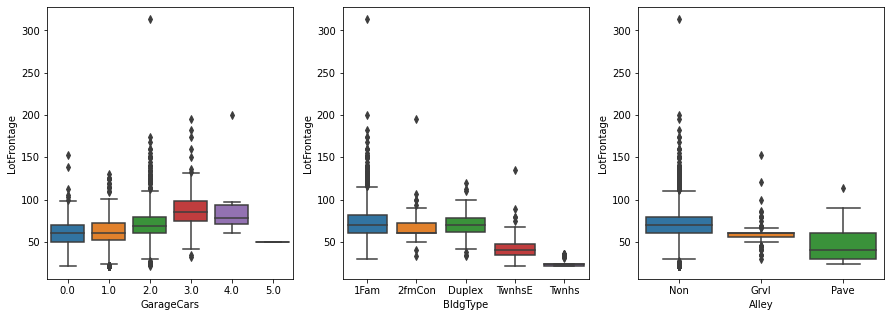

<AxesSubplot:xlabel='Alley', ylabel='LotFrontage'>

In [0]:
# To impute the missing values of LotFrontage using tree-based method, we first look at the features that are correlated with LotFrontage

# convert sparkdataframe to pandas dataframe to do visualization
df_raw_plt = df_raw_clean.toPandas()

f, axes = plt.subplots(1, 3, figsize=(15,5))
sns.boxplot(x=df_raw_plt['GarageCars'], y=df_raw_plt['LotFrontage'], data=df_raw_plt,ax=axes[0])
sns.boxplot(x=df_raw_plt['BldgType'], y=df_raw_plt['LotFrontage'], data=df_raw_plt,ax=axes[1])
sns.boxplot(x=df_raw_plt['Alley'], y=df_raw_plt['LotFrontage'], data=df_raw_plt,ax=axes[2])

Out[66]:

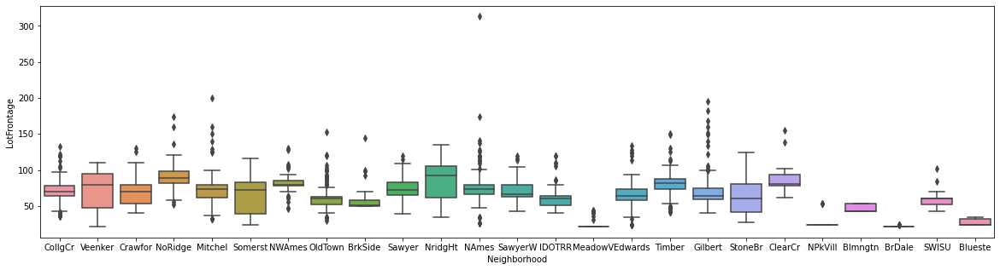

<AxesSubplot:xlabel='Neighborhood', ylabel='LotFrontage'>

In [0]:
# Features that are correlated with LotFrontage
f, axes = plt.subplots(1, 1, figsize=(20,5))
sns.boxplot(x=df_raw_plt['Neighborhood'], y=df_raw_plt['LotFrontage'], data=df_raw_plt)

Out[67]:

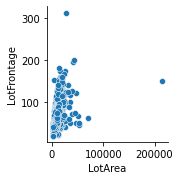

<seaborn.axisgrid.PairGrid at 0x7f21cc0e02b0>

In [0]:
# Features that are correlated with LotFrontage
sns.pairplot(x_vars=['LotArea'], y_vars=['LotFrontage'],data=df_raw_plt)

Out[68]:

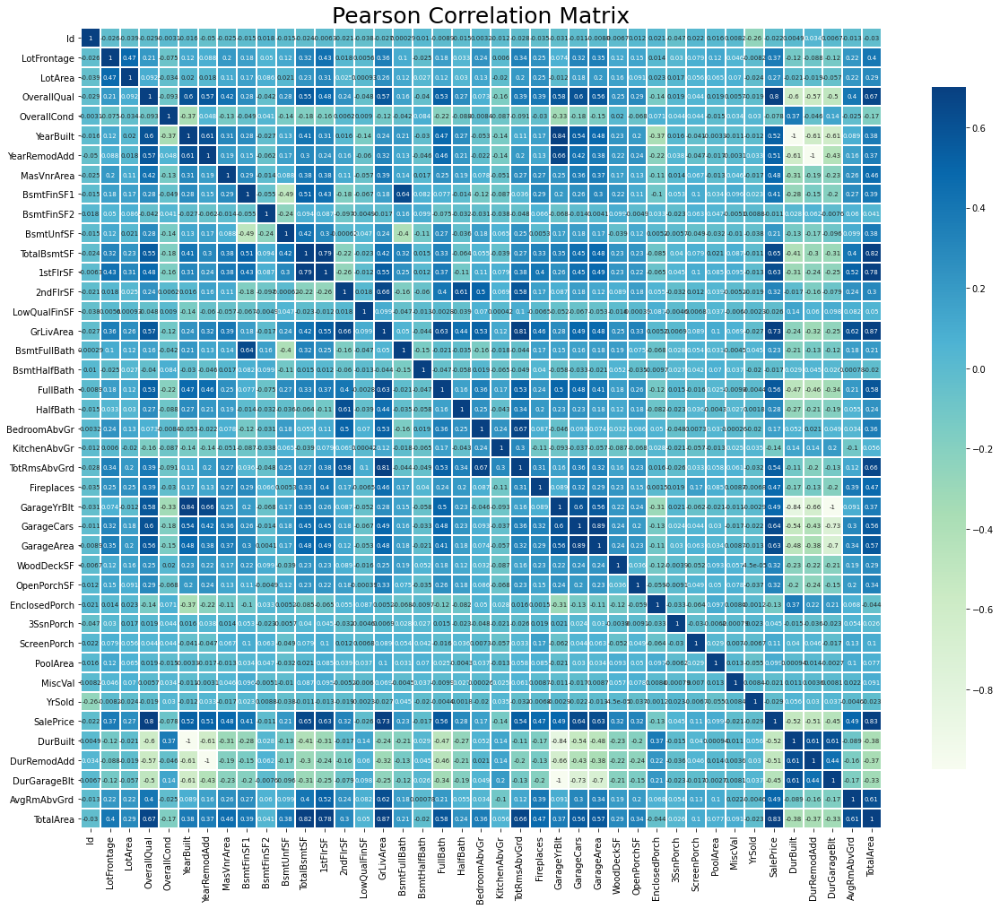

<AxesSubplot:title={'center':'Pearson Correlation Matrix'}>

In [0]:
plt.figure(figsize=(20,20))
plt.title('Pearson Correlation Matrix',fontsize=25)
sns.heatmap(df_raw_plt.corr(),linewidths=0.25,vmax=0.7,square=True,cmap="GnBu",
            linecolor='w', annot=True, annot_kws={"size":7}, cbar_kws={"shrink": .7})

#### Features with log transformation and label encoding

Out[69]:

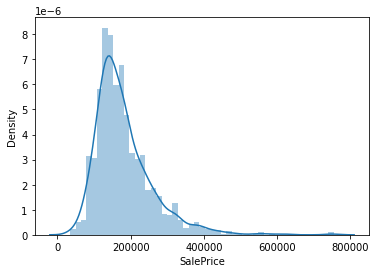

<AxesSubplot:xlabel='SalePrice', ylabel='Density'>

In [0]:
# plot to find the features need to be log transformed or label encoding

# plot saleprice
sns.distplot(df_raw_plt["SalePrice"])

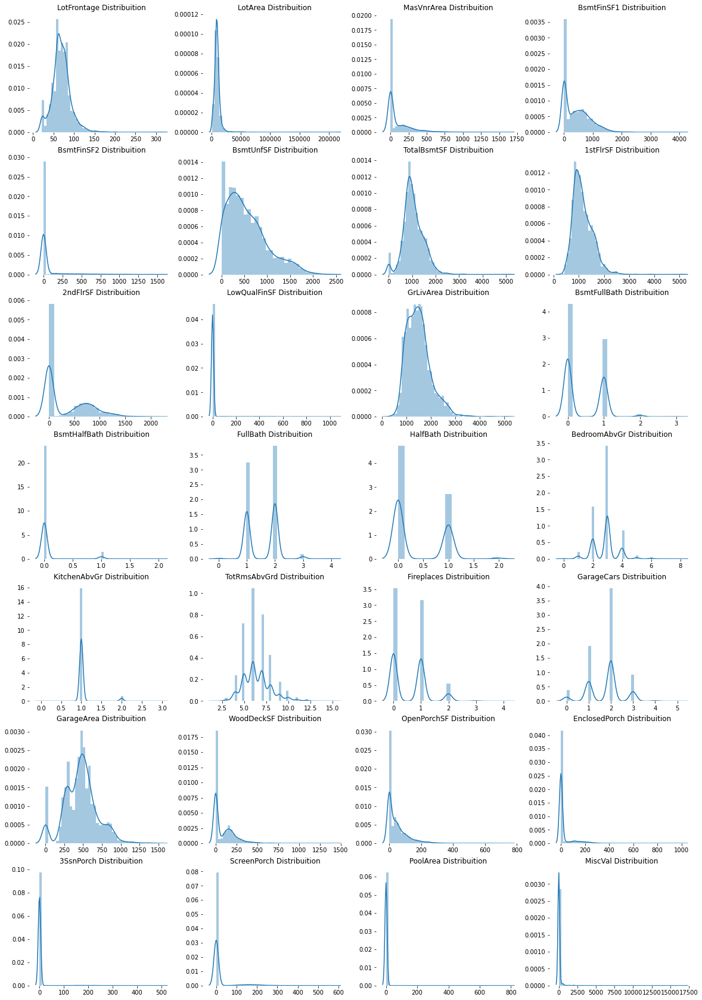

In [0]:
# plot the distributions of numeric features

f, axes = plt.subplots(7, 4, figsize=(20,30))

col_numeric = ['LotFrontage','LotArea','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF',
               'LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','FullBath','HalfBath','BedroomAbvGr','KitchenAbvGr',
               'TotRmsAbvGrd','Fireplaces','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch',
               'ScreenPorch','PoolArea','MiscVal']


for i in range(len(col_numeric)):
    m = i // 4
    n = i % 4
    sns.distplot(df_raw_plt[col_numeric[i]], ax=axes[m,n])
    sns.despine(bottom=True, left=True)
    axes[m,n].set(xlabel="", ylabel="", title='{} Distribuition'.format(col_numeric[i]))  

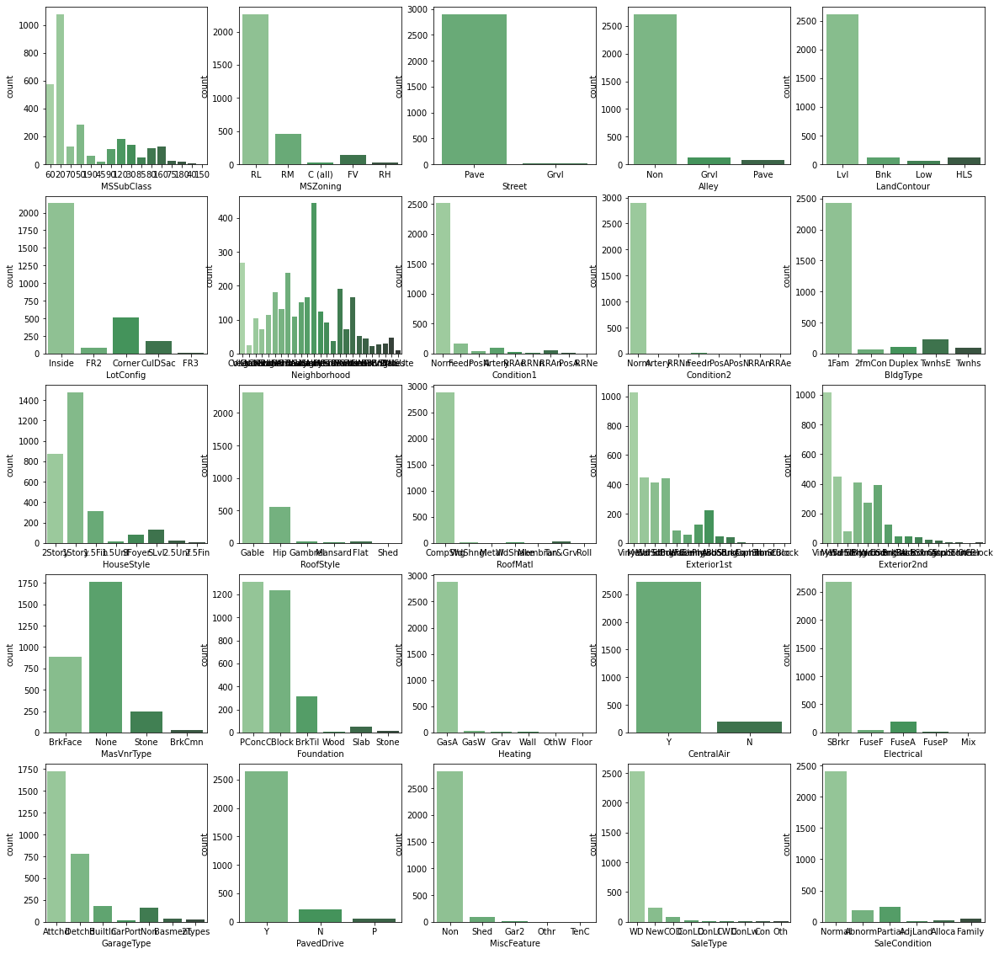

In [0]:
# plot the frequency of nominal features
               
f, axes = plt.subplots(5, 5, figsize=(20,20))

col_nominal = ['MSSubClass','MSZoning','Street','Alley','LandContour','LotConfig','Neighborhood','Condition1','Condition2',
               'BldgType','HouseStyle','RoofStyle','RoofMatl','Exterior1st','Exterior2nd','MasVnrType','Foundation','Heating',
               'CentralAir','Electrical','GarageType','PavedDrive','MiscFeature','SaleType','SaleCondition']
              

for i in range(len(col_nominal)):
    m = i // 5
    n = i % 5
    sns.countplot(x=col_nominal[i], data=df_raw_plt, palette="Greens_d", ax=axes[m,n])

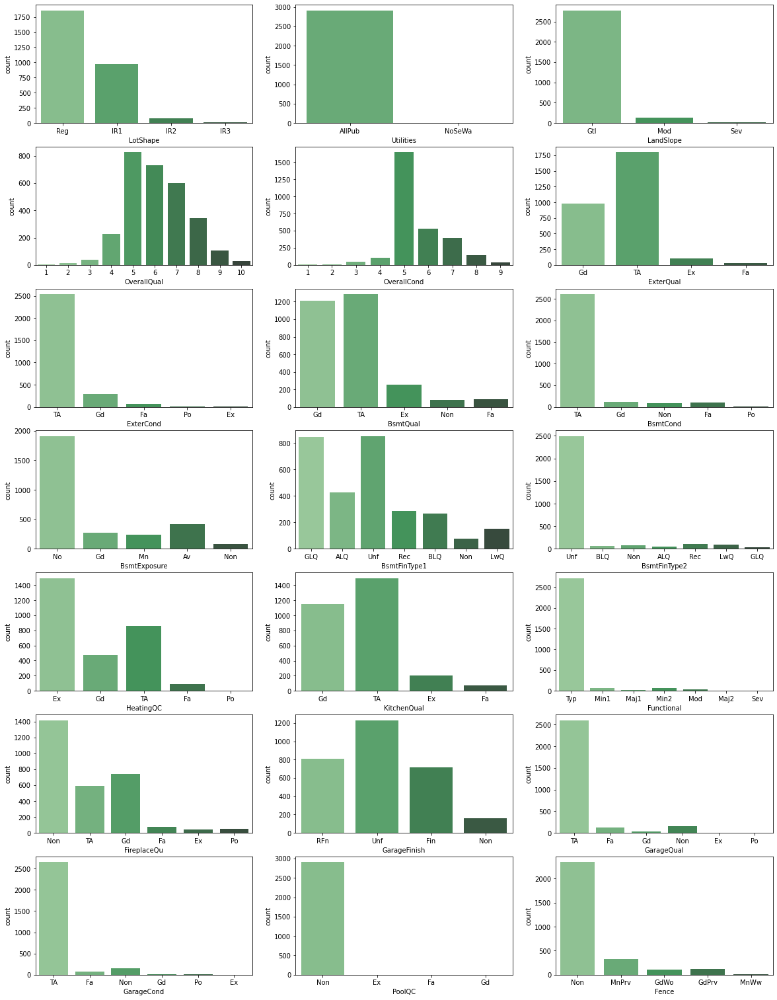

In [0]:
# plot the frequency of ordinal features
               
f, axes = plt.subplots(7, 3, figsize=(20,27))

col_ordinal = ['LotShape','Utilities','LandSlope','OverallQual','OverallCond','ExterQual','ExterCond','BsmtQual','BsmtCond',
               'BsmtExposure','BsmtFinType1','BsmtFinType2','HeatingQC','KitchenQual','Functional','FireplaceQu','GarageFinish',
               'GarageQual','GarageCond','PoolQC','Fence']

for i in range(len(col_ordinal)):
    m = i // 3
    n = i % 3
    sns.countplot(x=col_ordinal[i], data=df_raw_plt, palette="Greens_d", ax=axes[m,n])

Out[73]:

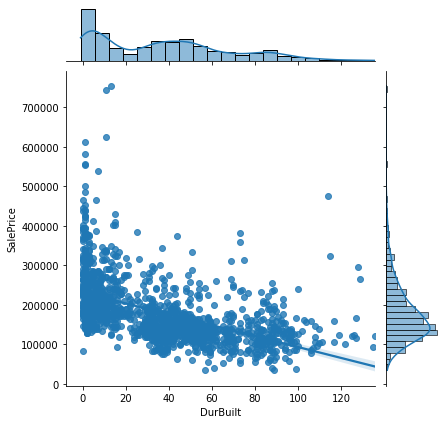

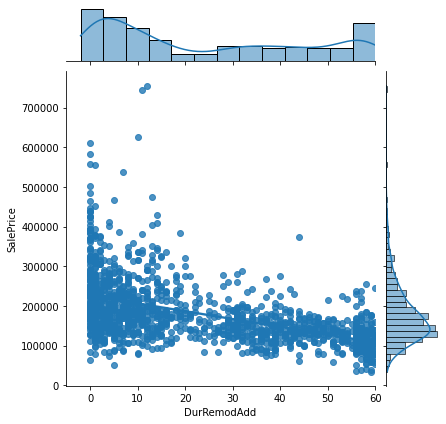

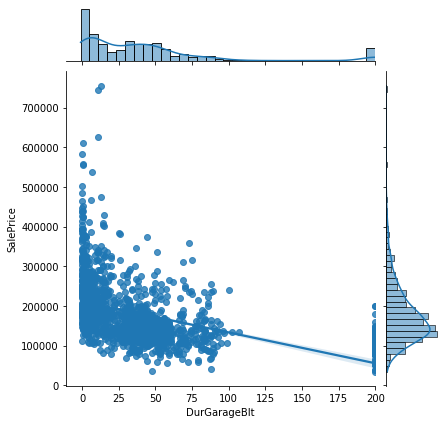

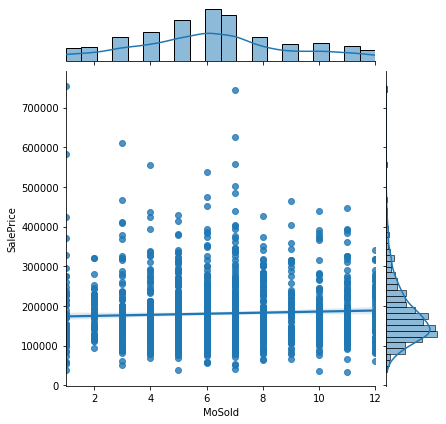

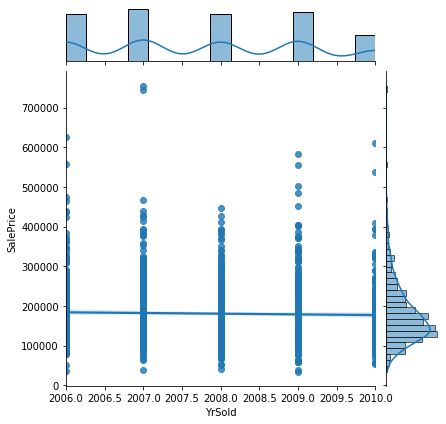

<seaborn.axisgrid.JointGrid at 0x7f21ad03c910>

In [0]:
# plot the relationship of time related features and SalePrice

col_time = ['DurBuilt','DurRemodAdd','DurGarageBlt','MoSold','YrSold']
df_raw_plt["MoSold"] = df_raw_plt["MoSold"].astype(float)

sns.jointplot(data=df_raw_plt, x='DurBuilt', y="SalePrice", kind='reg')
sns.jointplot(data=df_raw_plt, x='DurRemodAdd', y="SalePrice", kind='reg')
sns.jointplot(data=df_raw_plt, x='DurGarageBlt', y="SalePrice", kind='reg')
sns.jointplot(data=df_raw_plt, x='MoSold', y="SalePrice", kind='reg')
sns.jointplot(data=df_raw_plt, x='YrSold', y="SalePrice", kind='reg')

#### Feature engineering

In [0]:
%r
library(dplyr)
library(recipes)

# show the deleted columns from nzv

set.seed(1)
blueprint<-
    recipe(SalePrice ~., data = df_raw_clean_r) %>%
    # step 2.1: missing data
    step_impute_bag(LotFrontage, impute_with=imp_vars(Neighborhood,LotArea,Alley,GarageCars,BldgType)) %>%
    # step 2.2: feature filtering - nzv
    step_nzv(all_predictors(), -Id) 
prepare <- prep(blueprint, new_data = df_raw_clean_r)
baked <- bake(prepare, new_data = df_raw_clean_r)
setdiff(colnames(df_raw_clean_r),colnames(baked)) 

Attaching package: ‘dplyr’

The following objects are masked from ‘package:SparkR’:

 arrange, between, coalesce, collect, contains, count, cume_dist,
 dense_rank, desc, distinct, explain, expr, filter, first, group_by,
 intersect, lag, last, lead, mutate, n, n_distinct, ntile,
 percent_rank, rename, row_number, sample_frac, select, slice, sql,
 summarize, union

The following objects are masked from ‘package:stats’:

 filter, lag

The following objects are masked from ‘package:base’:

 intersect, setdiff, setequal, union


Attaching package: ‘recipes’

The following object is masked from ‘package:stats’:

 step

 [1] "Street" "Alley" "LandContour" "Utilities" 
 [5] "LandSlope" "Condition2" "RoofMatl" "BsmtCond" 
 [9] "BsmtFinType2" "BsmtFinSF2" "Heating" "LowQualFinSF" 
[13] "KitchenAbvGr" "Functional" "OpenPorchSF" "EnclosedPorch"
[17] "3SsnPorch" "ScreenPorch" "PoolArea" "PoolQC" 
[21] "MiscFeature" "MiscVal"

In [0]:
%r
set.seed(1)
blueprint<-
    recipe(SalePrice ~., data = df_raw_clean_r) %>%
    # step 2.1: missing data
    step_impute_bag(LotFrontage, impute_with=imp_vars(Neighborhood,LotArea,Alley,GarageCars,BldgType)) %>%
    # step 2.2: feature filtering - nzv
    step_nzv(all_predictors(), -Id) %>%
    # step 2.3: Numeric
    # step 2.3.1: Numeric - take log => step_log
    step_log(LotFrontage,LotArea,'1stFlrSF',GrLivArea,SalePrice)%>%
    step_log(MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF, '2ndFlrSF', BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,
             Fireplaces,WoodDeckSF, offset=1) %>%
    # step 2.4: Label (Ordinal) encoding
    step_integer('LotShape','ExterQual','ExterCond','BsmtQual','BsmtExposure','BsmtFinType1','HeatingQC',
                 'KitchenQual','FireplaceQu','GarageFinish','GarageQual','GarageCond','PavedDrive','Fence')%>%
    step_center(all_numeric(), -all_outcomes(), -Id) %>%
    step_scale(all_numeric(), -all_outcomes(), -Id) %>%
    # step 2.5: Categorical
    # step 2.5: Categorical - lumping => step_other
    step_other(all_nominal())

prepare <- prep(blueprint, new_data = df_raw_clean_r)
baked <- bake(prepare, new_data = df_raw_clean_r)
print(baked)

# A tibble: 2,917 × 61
 Id MSSubClass MSZoning LotFrontage LotArea LotShape LotConfig Neighborhood
 <int> <fct> <fct> <dbl> <dbl> <dbl> <fct> <fct> 
 1 1 60 RL -0.0601 -0.102 0.702 Inside CollgCr 
 2 2 20 RL 0.544 0.149 0.702 other other 
 3 3 60 RL 0.0711 0.462 -1.06 Inside CollgCr 
 4 4 other RL -0.293 0.139 -1.06 Corner other 
 5 5 60 RL 0.686 0.928 -1.06 other other 
 6 6 50 RL 0.720 0.908 -1.06 Inside other 
 7 7 20 RL 0.356 0.246 0.702 Inside Somerst 
 8 8 60 RL 0.428 0.304 -1.06 Corner other 
 9 9 50 RM -0.766 -0.737 0.702 Inside OldTown 
10 10 other RL -0.823 -0.358 0.702 Corner other 
# … with 2,907 more rows, and 53 more variables: Condition1 <fct>,
# BldgType <fct>, HouseStyle <fct>, OverallQual <dbl>, OverallCond <dbl>,
# DurBuilt <dbl>, DurRemodAdd <dbl>, RoofStyle <fct>, Exterior1st <fct>,
# Exterior2nd <fct>, MasVnrType <fct>, MasVnrArea <dbl>, ExterQual <dbl>,
# ExterCond <dbl>, Foundation <fct>, BsmtQual <dbl>, BsmtExposure <dbl>,
# BsmtFinType1 <dbl>, BsmtFinSF1 <dbl>, BsmtUnfSF <dbl>, TotalBsmtSF <dbl>,
# HeatingQC <dbl>, CentralAir <fct>, Electrical <fct>, 1stFlrSF <dbl>, …

In [0]:
%r
baked <- as.data.frame(baked)
df_raw_prep_r <- createDataFrame(baked)
display(df_raw_prep_r) 

Id,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,BldgType,HouseStyle,OverallQual,OverallCond,DurBuilt,DurRemodAdd,RoofStyle,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,AvgRmAbvGrd,TotRmsAbvGrd,TotalArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,Fireplaces,FireplaceQu,GarageType,DurGarageBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,Fence,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,60,RL,-0.060117899054394276,-0.10170308117784788,0.7022571278869482,Inside,CollgCr,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,-1.0386871276295317,-0.8877439238829301,Gable,VinylSd,VinylSd,BrkFace,1.2245739013708508,1.0439009540937478,-0.2300903584001946,PConc,0.5791232437373385,-0.5838344136034728,1.1639230495032733,0.7845548896347855,-0.32481981713424185,0.020082610534931683,0.8860092747994933,Y,SBrkr,-0.7782591025511891,1.1978525154832618,0.5701774573431042,-0.7326000635788856,0.9921086232302869,0.024015256691445972,1.1377286801979736,-0.2515929275035059,0.8139773073856753,1.265988440889682,0.2632552653075557,0.7413838509513181,-0.9857141126194702,-0.9779926051582712,Attchd,-0.7442673501060065,0.3173745646248169,0.30768523500348083,0.3527271627644869,0.27743487990090937,0.2680896497549428,0.3150943007525477,-0.9442793764467765,-0.4771779896003345,other,0.15742239027809474,WD,Normal,12.247694320220994
2,20,RL,0.5438541256538867,0.14943691003322346,0.7022571278869482,other,other,Feedr,1Fam,1Story,-0.061413142543790745,2.186999277005653,-0.18149333945021778,0.3568863501743615,Gable,MetalSd,MetalSd,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,CBlock,0.5791232437373385,2.226470841316214,0.6907954665321128,0.8937453791567268,0.014891519147984707,0.3481657289565658,0.8860092747994933,Y,SBrkr,0.4296726643884706,-0.8627767755990021,-0.3693494133135137,-0.655508347367577,-0.28643383489330354,-0.02969127924663385,-0.8337816813831949,3.886769485207395,0.8139773073856753,-0.7637670406443793,0.2632552653075557,-0.7709355149402866,0.7713609367438821,0.6828677262486824,Attchd,-0.17535691594783373,0.3173745646248169,0.30768523500348083,-0.05702824191937384,0.27743487990090937,0.2680896497549428,0.3150943007525477,1.254876630656175,-0.4771779896003345,5,-0.6028443521739778,WD,Normal,12.109010932687042
3,60,RL,0.07112638923924731,0.46160861412344384,-1.0576088876166838,Inside,CollgCr,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,-0.9727491439234306,-0.8398735287268805,Gable,VinylSd,VinylSd,BrkFace,1.1522506453032764,1.0439009540937478,-0.2300903584001946,PConc,0.5791232437373385,0.3529340047030895,1.1639230495032733,0.6595089935881041,0.24103628123086832,0.08101299224975576,0.8860092747994933,Y,SBrkr,-0.5538908691969517,1.2021066415750903,0.7046607424229453,0.7111946303499658,-0.28643383489330354,0.20303704315171206,1.1377286801979736,-0.2515929275035059,0.8139773073856753,1.265988440889682,0.2632552653075557,0.7413838509513181,0.7713609367438821,0.6828677262486824,Attchd,-0.7005050090169163,0.3173745646248169,0.30768523500348083,0.6321058477762102,0.27743487990090937,0.2680896497549428,0.3150943007525477,-0.9442793764467765,-0.4771779896003345,9,0.15742239027809474,WD,Normal,12.31716669303576
4,other,RL,-0.2929425191275148,0.1391589059280303,-1.0576088876166838,Corner,other,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,1.7966461717328142,0.5962383259546099,Gable,Wd Sdng,other,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,BrkTil,-0.531529288795086,-0.5838344136034728,0.6907954665321128,0.3883394131083484,0.3576623276936168,-0.08488398799395667,-0.15780698311251085,Y,SBrkr,-0.41821578090734196,1.1606945296558804,0.5828114974757957,1.2546106607393634,0.3528373941684917,-0.09490635860001649,1.1377286801979736,-0.2515929275035059,-1.02409112

In [0]:
%r
df_train_prep_r <- baked[which(baked$Id <= 1460),]
df_train_prep_r <- createDataFrame(df_train_prep_r)
display(df_train_prep_r) # You can download the csv file named "export_RtoSpark_train.csv" and import it on "/FileStore/final data/export_RtoSpark_train.csv" by yourself (Or, Use files that have been uploaded in DBFS）

Id,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,BldgType,HouseStyle,OverallQual,OverallCond,DurBuilt,DurRemodAdd,RoofStyle,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,AvgRmAbvGrd,TotRmsAbvGrd,TotalArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,Fireplaces,FireplaceQu,GarageType,DurGarageBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,Fence,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,60,RL,-0.060117899054394276,-0.10170308117784788,0.7022571278869482,Inside,CollgCr,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,-1.0386871276295317,-0.8877439238829301,Gable,VinylSd,VinylSd,BrkFace,1.2245739013708508,1.0439009540937478,-0.2300903584001946,PConc,0.5791232437373385,-0.5838344136034728,1.1639230495032733,0.7845548896347855,-0.32481981713424185,0.020082610534931683,0.8860092747994933,Y,SBrkr,-0.7782591025511891,1.1978525154832618,0.5701774573431042,-0.7326000635788856,0.9921086232302869,0.024015256691445972,1.1377286801979736,-0.2515929275035059,0.8139773073856753,1.265988440889682,0.2632552653075557,0.7413838509513181,-0.9857141126194702,-0.9779926051582712,Attchd,-0.7442673501060065,0.3173745646248169,0.30768523500348083,0.3527271627644869,0.27743487990090937,0.2680896497549428,0.3150943007525477,-0.9442793764467765,-0.4771779896003345,other,0.15742239027809474,WD,Normal,12.247694320220994
2,20,RL,0.5438541256538867,0.14943691003322346,0.7022571278869482,other,other,Feedr,1Fam,1Story,-0.061413142543790745,2.186999277005653,-0.18149333945021778,0.3568863501743615,Gable,MetalSd,MetalSd,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,CBlock,0.5791232437373385,2.226470841316214,0.6907954665321128,0.8937453791567268,0.014891519147984707,0.3481657289565658,0.8860092747994933,Y,SBrkr,0.4296726643884706,-0.8627767755990021,-0.3693494133135137,-0.655508347367577,-0.28643383489330354,-0.02969127924663385,-0.8337816813831949,3.886769485207395,0.8139773073856753,-0.7637670406443793,0.2632552653075557,-0.7709355149402866,0.7713609367438821,0.6828677262486824,Attchd,-0.17535691594783373,0.3173745646248169,0.30768523500348083,-0.05702824191937384,0.27743487990090937,0.2680896497549428,0.3150943007525477,1.254876630656175,-0.4771779896003345,5,-0.6028443521739778,WD,Normal,12.109010932687042
3,60,RL,0.07112638923924731,0.46160861412344384,-1.0576088876166838,Inside,CollgCr,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,-0.9727491439234306,-0.8398735287268805,Gable,VinylSd,VinylSd,BrkFace,1.1522506453032764,1.0439009540937478,-0.2300903584001946,PConc,0.5791232437373385,0.3529340047030895,1.1639230495032733,0.6595089935881041,0.24103628123086832,0.08101299224975576,0.8860092747994933,Y,SBrkr,-0.5538908691969517,1.2021066415750903,0.7046607424229453,0.7111946303499658,-0.28643383489330354,0.20303704315171206,1.1377286801979736,-0.2515929275035059,0.8139773073856753,1.265988440889682,0.2632552653075557,0.7413838509513181,0.7713609367438821,0.6828677262486824,Attchd,-0.7005050090169163,0.3173745646248169,0.30768523500348083,0.6321058477762102,0.27743487990090937,0.2680896497549428,0.3150943007525477,-0.9442793764467765,-0.4771779896003345,9,0.15742239027809474,WD,Normal,12.31716669303576
4,other,RL,-0.2929425191275148,0.1391589059280303,-1.0576088876166838,Corner,other,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,1.7966461717328142,0.5962383259546099,Gable,Wd Sdng,other,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,BrkTil,-0.531529288795086,-0.5838344136034728,0.6907954665321128,0.3883394131083484,0.3576623276936168,-0.08488398799395667,-0.15780698311251085,Y,SBrkr,-0.41821578090734196,1.1606945296558804,0.5828114974757957,1.2546106607393634,0.3528373941684917,-0.09490635860001649,1.1377286801979736,-0.2515929275035059,-1.02409112

In [0]:
%r
df_test_prep_r <- baked[which(baked$Id > 1460),]
df_test_prep_r <- createDataFrame(df_test_prep_r)
display(df_test_prep_r) # You can download the csv file named "export_RtoSpark_test.csv" and import it on "/FileStore/final data/export_RtoSpark_test.csv" by yourself (Or, Use files that have been uploaded in DBFS）

Id,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,BldgType,HouseStyle,OverallQual,OverallCond,DurBuilt,DurRemodAdd,RoofStyle,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,AvgRmAbvGrd,TotRmsAbvGrd,TotalArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,Fireplaces,FireplaceQu,GarageType,DurGarageBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,Fence,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1461,20,other,0.5438541256538867,0.5256386390205743,0.7022571278869482,Inside,NAmes,Feedr,1Fam,1Story,-0.7722946377828305,0.3907225232324613,0.41194851390469184,1.2185534629832557,Gable,VinylSd,VinylSd,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,CBlock,-0.531529288795086,-0.5838344136034728,-0.25545969941020846,0.6468753548466054,-0.012046658436115385,0.045367114244117074,-1.201623241024515,Y,SBrkr,-0.6361448532978083,-0.8627767755990021,-1.4286136448174858,-0.9381779734757101,-0.9257050639550988,-0.9836216556706231,-0.8337816813831949,-0.2515929275035059,-1.0240911252923706,-0.7637670406443793,-1.001562198171842,-0.7709355149402866,-0.9857141126194702,-0.9779926051582712,Attchd,0.2185041538539782,-0.7980249594843281,-1.0044753359104865,1.2001758406333807,0.27743487990090937,0.2680896497549428,0.3150943007525477,0.9648869718417844,1.9864117372389138,6,1.6779558751822399,WD,Normal,null
1462,20,RL,0.5799881918677815,0.929223550382514,-1.0576088876166838,Corner,NAmes,Norm,1Fam,1Story,-0.061413142543790745,0.3907225232324613,0.5108554894638434,1.3621646484514047,Hip,Wd Sdng,Wd Sdng,BrkFace,0.9986348945359458,-0.6833021559978357,-0.2300903584001946,CBlock,-0.531529288795086,-0.5838344136034728,0.6907954665321128,0.874349593268196,0.20545437089843832,0.39189446988771204,-1.201623241024515,Y,SBrkr,0.5906410088016715,-0.8627767755990021,-0.20937079895234068,-0.37423807584413743,-0.28643383489330354,0.14165814493676368,-0.8337816813831949,-0.2515929275035059,-1.0240911252923706,1.265988440889682,0.2632552653075557,0.7413838509513181,-0.9857141126194702,-0.9779926051582712,Attchd,0.2841476654876135,-0.7980249594843281,-1.0044753359104865,-0.7461623316149578,0.27743487990090937,0.2680896497549428,0.3150943007525477,1.3613180447939321,-0.4771779896003345,6,1.6779558751822399,WD,Normal,null
1463,60,RL,0.3170831080237388,0.8679937163502948,-1.0576088876166838,Inside,Gilbert,Norm,1Fam,2Story,-0.7722946377828305,-0.5074158536541346,-0.7749351928051273,-0.5526511577905824,Gable,VinylSd,VinylSd,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,PConc,0.5791232437373385,-0.5838344136034728,1.1639230495032733,0.8226391856235282,-0.3729659985391098,0.08832975500776137,-0.15780698311251085,Y,SBrkr,-0.526949045365704,1.1376711818607503,0.42010136040764184,0.12533151089152395,-0.28643383489330354,0.012506713276143154,-0.8337816813831949,-0.2515929275035059,0.8139773073856753,1.265988440889682,0.2632552653075557,-0.7709355149402866,0.7713609367438821,0.6828677262486824,Attchd,-0.5692179857496457,1.4327740887339617,0.30768523500348083,0.045410609251591336,0.27743487990090937,0.2680896497549428,0.3150943007525477,1.1240364870923942,1.9864117372389138,3,1.6779558751822399,WD,Normal,null
1464,60,RL,0.4702108270155113,0.22544923616164383,-1.0576088876166838,Inside,Gilbert,Norm,1Fam,2Story,-0.061413142543790745,0.3907225232324613,-0.8079041846581779,-0.5526511577905824,Gable,VinylSd,VinylSd,BrkFace,0.36996474190189127,-0.6833021559978357,-0.2300903584001946,PConc,-0.531529288795086,-0.5838344136034728,1.1639230495032733,0.7311796962089346,0.08513029825591066,0.08650648830952828,0.8860092747994933,Y,SBrkr,-0.5336626643968115,1.127503322148285,0.3722713282221652,-0.5665093957810556,0.3528373941684917,-0.022018916969765306,-0.8337816813831949,-0.2515929275035059,0.8139773073856753,1.265988

# Part 2: Use Machine Learning to predict Saleprice

## 2.0 StringIndexer, OneHotEncoder and VectorAssembler

In [0]:
# file locations
file_location_train = "/FileStore/final data/export_RtoSpark_train.csv"
file_location_test = "/FileStore/final data/export_RtoSpark_test.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

# CSV options are applied. For other types, these options will be ignored.
df_train_prep = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location_train)
df_test_prep = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location_test)
display(df_train_prep)
display(df_test_prep)

Id,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,BldgType,HouseStyle,OverallQual,OverallCond,DurBuilt,DurRemodAdd,RoofStyle,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,AvgRmAbvGrd,TotRmsAbvGrd,TotalArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,Fireplaces,FireplaceQu,GarageType,DurGarageBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,Fence,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1,60,RL,-0.060117899054394276,-0.10170308117784788,0.7022571278869482,Inside,CollgCr,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,-1.0386871276295317,-0.8877439238829301,Gable,VinylSd,VinylSd,BrkFace,1.2245739013708508,1.0439009540937478,-0.2300903584001946,PConc,0.5791232437373385,-0.5838344136034728,1.1639230495032733,0.7845548896347855,-0.32481981713424185,0.020082610534931683,0.8860092747994933,Y,SBrkr,-0.7782591025511891,1.1978525154832618,0.5701774573431042,-0.7326000635788856,0.9921086232302869,0.024015256691445972,1.1377286801979736,-0.2515929275035059,0.8139773073856753,1.265988440889682,0.2632552653075557,0.7413838509513181,-0.9857141126194702,-0.9779926051582712,Attchd,-0.7442673501060065,0.3173745646248169,0.30768523500348083,0.3527271627644869,0.27743487990090937,0.2680896497549428,0.3150943007525477,-0.9442793764467765,-0.4771779896003345,other,0.15742239027809474,WD,Normal,12.247694320220994
2,20,RL,0.5438541256538867,0.14943691003322346,0.7022571278869482,other,other,Feedr,1Fam,1Story,-0.061413142543790745,2.186999277005653,-0.18149333945021778,0.3568863501743615,Gable,MetalSd,MetalSd,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,CBlock,0.5791232437373385,2.226470841316214,0.6907954665321128,0.8937453791567268,0.014891519147984707,0.3481657289565658,0.8860092747994933,Y,SBrkr,0.4296726643884706,-0.8627767755990021,-0.3693494133135137,-0.655508347367577,-0.28643383489330354,-0.02969127924663385,-0.8337816813831949,3.886769485207395,0.8139773073856753,-0.7637670406443793,0.2632552653075557,-0.7709355149402866,0.7713609367438821,0.6828677262486824,Attchd,-0.17535691594783373,0.3173745646248169,0.30768523500348083,-0.05702824191937384,0.27743487990090937,0.2680896497549428,0.3150943007525477,1.254876630656175,-0.4771779896003345,5,-0.6028443521739778,WD,Normal,12.109010932687042
3,60,RL,0.07112638923924731,0.46160861412344384,-1.0576088876166838,Inside,CollgCr,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,-0.9727491439234306,-0.8398735287268805,Gable,VinylSd,VinylSd,BrkFace,1.1522506453032764,1.0439009540937478,-0.2300903584001946,PConc,0.5791232437373385,0.3529340047030895,1.1639230495032733,0.6595089935881041,0.24103628123086832,0.08101299224975576,0.8860092747994933,Y,SBrkr,-0.5538908691969517,1.2021066415750903,0.7046607424229453,0.7111946303499658,-0.28643383489330354,0.20303704315171206,1.1377286801979736,-0.2515929275035059,0.8139773073856753,1.265988440889682,0.2632552653075557,0.7413838509513181,0.7713609367438821,0.6828677262486824,Attchd,-0.7005050090169163,0.3173745646248169,0.30768523500348083,0.6321058477762102,0.27743487990090937,0.2680896497549428,0.3150943007525477,-0.9442793764467765,-0.4771779896003345,9,0.15742239027809474,WD,Normal,12.31716669303576
4,other,RL,-0.2929425191275148,0.1391589059280303,-1.0576088876166838,Corner,other,Norm,1Fam,2Story,0.649468352695249,-0.5074158536541346,1.7966461717328142,0.5962383259546099,Gable,Wd Sdng,other,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,BrkTil,-0.531529288795086,-0.5838344136034728,0.6907954665321128,0.3883394131083484,0.3576623276936168,-0.08488398799395667,-0.15780698311251085,Y,SBrkr,-0.41821578090734196,1.1606945296558804,0.5828114974757957,1.2546106607393634,0.3528373941684917,-0.09490635860001649,1.1377286801979736,-0.2515929275035059,-1.02409112

Id,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,BldgType,HouseStyle,OverallQual,OverallCond,DurBuilt,DurRemodAdd,RoofStyle,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,AvgRmAbvGrd,TotRmsAbvGrd,TotalArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,Fireplaces,FireplaceQu,GarageType,DurGarageBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,Fence,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1461,20,other,0.5438541256538867,0.5256386390205743,0.7022571278869482,Inside,NAmes,Feedr,1Fam,1Story,-0.7722946377828305,0.3907225232324613,0.41194851390469184,1.2185534629832557,Gable,VinylSd,VinylSd,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,CBlock,-0.531529288795086,-0.5838344136034728,-0.25545969941020846,0.6468753548466054,-0.012046658436115385,0.045367114244117074,-1.201623241024515,Y,SBrkr,-0.6361448532978083,-0.8627767755990021,-1.4286136448174858,-0.9381779734757101,-0.9257050639550988,-0.9836216556706231,-0.8337816813831949,-0.2515929275035059,-1.0240911252923706,-0.7637670406443793,-1.001562198171842,-0.7709355149402866,-0.9857141126194702,-0.9779926051582712,Attchd,0.2185041538539782,-0.7980249594843281,-1.0044753359104865,1.2001758406333807,0.27743487990090937,0.2680896497549428,0.3150943007525477,0.9648869718417844,1.9864117372389138,6,1.6779558751822399,WD,Normal,null
1462,20,RL,0.5799881918677815,0.929223550382514,-1.0576088876166838,Corner,NAmes,Norm,1Fam,1Story,-0.061413142543790745,0.3907225232324613,0.5108554894638434,1.3621646484514047,Hip,Wd Sdng,Wd Sdng,BrkFace,0.9986348945359458,-0.6833021559978357,-0.2300903584001946,CBlock,-0.531529288795086,-0.5838344136034728,0.6907954665321128,0.874349593268196,0.20545437089843832,0.39189446988771204,-1.201623241024515,Y,SBrkr,0.5906410088016715,-0.8627767755990021,-0.20937079895234068,-0.37423807584413743,-0.28643383489330354,0.14165814493676368,-0.8337816813831949,-0.2515929275035059,-1.0240911252923706,1.265988440889682,0.2632552653075557,0.7413838509513181,-0.9857141126194702,-0.9779926051582712,Attchd,0.2841476654876135,-0.7980249594843281,-1.0044753359104865,-0.7461623316149578,0.27743487990090937,0.2680896497549428,0.3150943007525477,1.3613180447939321,-0.4771779896003345,6,1.6779558751822399,WD,Normal,null
1463,60,RL,0.3170831080237388,0.8679937163502948,-1.0576088876166838,Inside,Gilbert,Norm,1Fam,2Story,-0.7722946377828305,-0.5074158536541346,-0.7749351928051273,-0.5526511577905824,Gable,VinylSd,VinylSd,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,PConc,0.5791232437373385,-0.5838344136034728,1.1639230495032733,0.8226391856235282,-0.3729659985391098,0.08832975500776137,-0.15780698311251085,Y,SBrkr,-0.526949045365704,1.1376711818607503,0.42010136040764184,0.12533151089152395,-0.28643383489330354,0.012506713276143154,-0.8337816813831949,-0.2515929275035059,0.8139773073856753,1.265988440889682,0.2632552653075557,-0.7709355149402866,0.7713609367438821,0.6828677262486824,Attchd,-0.5692179857496457,1.4327740887339617,0.30768523500348083,0.045410609251591336,0.27743487990090937,0.2680896497549428,0.3150943007525477,1.1240364870923942,1.9864117372389138,3,1.6779558751822399,WD,Normal,null
1464,60,RL,0.4702108270155113,0.22544923616164383,-1.0576088876166838,Inside,Gilbert,Norm,1Fam,2Story,-0.061413142543790745,0.3907225232324613,-0.8079041846581779,-0.5526511577905824,Gable,VinylSd,VinylSd,BrkFace,0.36996474190189127,-0.6833021559978357,-0.2300903584001946,PConc,-0.531529288795086,-0.5838344136034728,1.1639230495032733,0.7311796962089346,0.08513029825591066,0.08650648830952828,0.8860092747994933,Y,SBrkr,-0.5336626643968115,1.127503322148285,0.3722713282221652,-0.5665093957810556,0.3528373941684917,-0.022018916969765306,-0.8337816813831949,-0.2515929275035059,0.8139773073856753,1.265988

In [0]:
df_train_prep.printSchema()

root
-- Id: integer (nullable = true)
-- MSSubClass: string (nullable = true)
-- MSZoning: string (nullable = true)
-- LotFrontage: double (nullable = true)
-- LotArea: double (nullable = true)
-- LotShape: double (nullable = true)
-- LotConfig: string (nullable = true)
-- Neighborhood: string (nullable = true)
-- Condition1: string (nullable = true)
-- BldgType: string (nullable = true)
-- HouseStyle: string (nullable = true)
-- OverallQual: double (nullable = true)
-- OverallCond: double (nullable = true)
-- DurBuilt: double (nullable = true)
-- DurRemodAdd: double (nullable = true)
-- RoofStyle: string (nullable = true)
-- Exterior1st: string (nullable = true)
-- Exterior2nd: string (nullable = true)
-- MasVnrType: string (nullable = true)
-- MasVnrArea: double (nullable = true)
-- ExterQual: double (nullable = true)
-- ExterCond: double (nullable = true)
-- Foundation: string (nullable = true)
-- BsmtQual: double (nullable = true)
-- BsmtExposure: double (nullable = true)
-- BsmtFinType1: double (nullable = true)
-- BsmtFinSF1: double (nullable = true)
-- BsmtUnfSF: double (nullable = true)
-- TotalBsmtSF: double (nullable = true)
-- HeatingQC: double (nullable = true)
-- CentralAir: string (nullable = true)
-- Electrical: string (nullable = true)
-- 1stFlrSF: double (nullable = true)
-- 2ndFlrSF: double (nullable = true)
-- GrLivArea: double (nullable = true)
-- AvgRmAbvGrd: double (nullable = true)
-- TotRmsAbvGrd: double (nullable = true)
-- TotalArea: double (nullable = true)
-- BsmtFullBath: double (nullable = true)
-- BsmtHalfBath: double (nullable = true)
-- FullBath: double (nullable = true)
-- HalfBath: double (nullable = true)
-- BedroomAbvGr: double (nullable = true)
-- KitchenQual: double (nullable = true)
-- Fireplaces: double (nullable = true)
-- FireplaceQu: double (nullable = true)
-- GarageType: string (nullable = true)
-- DurGarageBlt: double (nullable = true)
-- GarageFinish: double (nullable = true)
-- GarageCars: double (nullable = true)
-- GarageArea: double (nullable = true)
-- GarageQual: double (nullable = true)
-- GarageCond: double (nullable = true)
-- PavedDrive: double (nullable = true)
-- WoodDeckSF: double (nullable = true)
-- Fence: double (nullable = true)
-- MoSold: string (nullable = true)
-- YrSold: double (nullable = true)
-- SaleType: string (nullable = true)
-- SaleCondition: string (nullable = true)
-- SalePrice: double (nullable = true)

In [0]:
df_test_prep.printSchema()

root
-- Id: integer (nullable = true)
-- MSSubClass: string (nullable = true)
-- MSZoning: string (nullable = true)
-- LotFrontage: double (nullable = true)
-- LotArea: double (nullable = true)
-- LotShape: double (nullable = true)
-- LotConfig: string (nullable = true)
-- Neighborhood: string (nullable = true)
-- Condition1: string (nullable = true)
-- BldgType: string (nullable = true)
-- HouseStyle: string (nullable = true)
-- OverallQual: double (nullable = true)
-- OverallCond: double (nullable = true)
-- DurBuilt: double (nullable = true)
-- DurRemodAdd: double (nullable = true)
-- RoofStyle: string (nullable = true)
-- Exterior1st: string (nullable = true)
-- Exterior2nd: string (nullable = true)
-- MasVnrType: string (nullable = true)
-- MasVnrArea: double (nullable = true)
-- ExterQual: double (nullable = true)
-- ExterCond: double (nullable = true)
-- Foundation: string (nullable = true)
-- BsmtQual: double (nullable = true)
-- BsmtExposure: double (nullable = true)
-- BsmtFinType1: double (nullable = true)
-- BsmtFinSF1: double (nullable = true)
-- BsmtUnfSF: double (nullable = true)
-- TotalBsmtSF: double (nullable = true)
-- HeatingQC: double (nullable = true)
-- CentralAir: string (nullable = true)
-- Electrical: string (nullable = true)
-- 1stFlrSF: double (nullable = true)
-- 2ndFlrSF: double (nullable = true)
-- GrLivArea: double (nullable = true)
-- AvgRmAbvGrd: double (nullable = true)
-- TotRmsAbvGrd: double (nullable = true)
-- TotalArea: double (nullable = true)
-- BsmtFullBath: double (nullable = true)
-- BsmtHalfBath: double (nullable = true)
-- FullBath: double (nullable = true)
-- HalfBath: double (nullable = true)
-- BedroomAbvGr: double (nullable = true)
-- KitchenQual: double (nullable = true)
-- Fireplaces: double (nullable = true)
-- FireplaceQu: double (nullable = true)
-- GarageType: string (nullable = true)
-- DurGarageBlt: double (nullable = true)
-- GarageFinish: double (nullable = true)
-- GarageCars: double (nullable = true)
-- GarageArea: double (nullable = true)
-- GarageQual: double (nullable = true)
-- GarageCond: double (nullable = true)
-- PavedDrive: double (nullable = true)
-- WoodDeckSF: double (nullable = true)
-- Fence: double (nullable = true)
-- MoSold: string (nullable = true)
-- YrSold: double (nullable = true)
-- SaleType: string (nullable = true)
-- SaleCondition: string (nullable = true)
-- SalePrice: string (nullable = true)

In [0]:
# for train data
from pyspark.ml.feature import OneHotEncoder, StringIndexer, VectorAssembler
 
# Find out the categorical columns as input columns and specify the names of output columns
categorical_cols = [field for (field, data_type) in df_train_prep.dtypes if data_type == "string"]
index_output_cols = [x + "Index" for x in categorical_cols]
ohe_output_cols = [x + "OHE" for x in categorical_cols]

# Find out the numeric columns and add them into features if it is not the LogSalePrice and Id label
string_indexer = StringIndexer(inputCols=categorical_cols, outputCols=index_output_cols, handleInvalid="keep") # when the value is unseen, keep it
ohe_encoder = OneHotEncoder(inputCols=index_output_cols, outputCols=ohe_output_cols)
numeric_cols = [field for (field, data_type) in df_train_prep.dtypes if ((data_type == "double") & (field not in ["SalePrice", "Id"]))]
assembler_inputs = ohe_output_cols + numeric_cols
vector_assembler = VectorAssembler(inputCols=assembler_inputs, outputCol="features")

## 2.1 Final Model

In [0]:
from pyspark.sql.types import DoubleType, StringType, BinaryType, StructField, StructType
from pyspark.ml.feature import OneHotEncoder, StringIndexer, VectorAssembler
from sparkdl.xgboost import XgboostRegressor
import xgboost as xgb
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml import Pipeline
from pyspark.sql.functions import exp
import numpy as np

**Best hyperparameter**

In [0]:
# Use XgboostRegressor to set xgb_regressor
xgb_regressor = XgboostRegressor(num_workers=1, labelCol="SalePrice", missing=0.0)

In [0]:
paramGrid = ParamGridBuilder().addGrid(xgb_regressor.max_depth, [20]).addGrid(xgb_regressor.n_estimators, [800]).addGrid(xgb_regressor.gamma, [0.01]).addGrid(xgb_regressor.min_child_weight, [8]).addGrid(xgb_regressor.reg_alpha, [0.5]).addGrid(xgb_regressor.learning_rate, [0.05]).addGrid(xgb_regressor.reg_lambda, [5]).build()
evaluator = RegressionEvaluator(metricName="rmse", labelCol=xgb_regressor.getLabelCol(), predictionCol=xgb_regressor.getPredictionCol())
cross_validator = CrossValidator(estimator=xgb_regressor, evaluator=evaluator, estimatorParamMaps=paramGrid, numFolds = 5, parallelism = 5, seed = 42)

In [0]:
pipeline = Pipeline(stages=[string_indexer, ohe_encoder, vector_assembler, cross_validator])

In [0]:
pipeline_model = pipeline.fit(df_train_prep)

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.

In [0]:
# see how does it perform on the training dataset.
pred_train_xgb = pipeline_model.transform(df_train_prep)

regressionEvaluator = RegressionEvaluator(predictionCol="prediction", labelCol="SalePrice", metricName="rmse")

rmse = regressionEvaluator.evaluate(pred_train_xgb)
r2 = regressionEvaluator.setMetricName("r2").evaluate(pred_train_xgb)
print(f"RMSE_train is {rmse}")
print(f"R2_train is {r2}")

RMSE_train is 0.05610210142845527
R2_train is 0.9802869231047405

**Predict**

In [0]:
predictions = pipeline_model.transform(df_test_prep)
display(predictions)

Id,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,Condition1,BldgType,HouseStyle,OverallQual,OverallCond,DurBuilt,DurRemodAdd,RoofStyle,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,AvgRmAbvGrd,TotRmsAbvGrd,TotalArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,Fireplaces,FireplaceQu,GarageType,DurGarageBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,Fence,MoSold,YrSold,SaleType,SaleCondition,SalePrice,MSSubClassIndex,MSZoningIndex,LotConfigIndex,NeighborhoodIndex,Condition1Index,BldgTypeIndex,HouseStyleIndex,RoofStyleIndex,Exterior1stIndex,Exterior2ndIndex,MasVnrTypeIndex,FoundationIndex,CentralAirIndex,ElectricalIndex,GarageTypeIndex,MoSoldIndex,SaleTypeIndex,SaleConditionIndex,MSSubClassOHE,MSZoningOHE,LotConfigOHE,NeighborhoodOHE,Condition1OHE,BldgTypeOHE,HouseStyleOHE,RoofStyleOHE,Exterior1stOHE,Exterior2ndOHE,MasVnrTypeOHE,FoundationOHE,CentralAirOHE,ElectricalOHE,GarageTypeOHE,MoSoldOHE,SaleTypeOHE,SaleConditionOHE,features,prediction
1461,20,other,0.5438541256538867,0.5256386390205743,0.7022571278869482,Inside,NAmes,Feedr,1Fam,1Story,-0.7722946377828305,0.3907225232324613,0.41194851390469184,1.2185534629832557,Gable,VinylSd,VinylSd,None,-0.7922716031868002,-0.6833021559978357,-0.2300903584001946,CBlock,-0.531529288795086,-0.5838344136034728,-0.25545969941020846,0.6468753548466054,-0.012046658436115385,0.045367114244117074,-1.201623241024515,Y,SBrkr,-0.6361448532978083,-0.8627767755990021,-1.4286136448174858,-0.9381779734757101,-0.9257050639550988,-0.9836216556706231,-0.8337816813831949,-0.2515929275035059,-1.0240911252923706,-0.7637670406443793,-1.001562198171842,-0.7709355149402866,-0.9857141126194702,-0.9779926051582712,Attchd,0.2185041538539782,-0.7980249594843281,-1.0044753359104865,1.2001758406333807,0.27743487990090937,0.2680896497549428,0.3150943007525477,0.9648869718417844,1.9864117372389138,6,1.6779558751822399,WD,Normal,null,0.0,2.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 3, indices -> List(2), values -> List(1.0))","Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 9, indices -> List(1), values -> List(1.0))","Map(vectorType -> sparse, length -> 3, indices -> List(2), values -> List(1.0))","Map(vectorType -> sparse, length -> 3, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 3, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 6, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 6, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 4, indices -> List(1), values -> List(1.0))","Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 3, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 9, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 3, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))","Map(vectorType -> sparse, length -> 121, indices -> List(0, 7, 8, 13, 23, 24, 27, 31, 34, 40, 46, 51, 54, 56, 59, 64, 73, 76, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120), values -> List(1.0, 1

**Results on Kaggle**

In [0]:
#Exponential of Log_SalePrice
exp_predictions_SalePrice = predictions.withColumn("SalePrice", exp("SalePrice"))
exp_predictions_SalePrice.Prediction = predictions.withColumn("prediction", exp("prediction"))

df_results = exp_predictions_SalePrice.Prediction.select("Id", "prediction").withColumnRenamed("prediction", "SalePrice")
display(df_results) # This is the final data that we uploaded on Kaggle

Id,SalePrice
1461,117387.96964882991
1462,164072.9093739748
1463,183536.12224298294
1464,189119.62688236794
1465,194563.80495085687
1466,169039.80193609712
1467,165686.5092201681
1468,167239.56410121924
1469,184976.84874019583
1470,123431.08497933712
